<a href="https://colab.research.google.com/github/krishnaaxo/Spotify-Skip-Action-Prediction/blob/main/Sportify_EDA_Krishna.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# ***Libraries***

In [3]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import dask
from dask import delayed
import dask.array as da
import math
import statsmodels.api as sm
from sklearn import preprocessing
%matplotlib inline
import seaborn as sns
sns.set()

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
#cd /content/drive/MyDrive/Dataset_Technolab

/content/drive/MyDrive/Dataset_Technolab


In [ ]:
#!wget https://os.zhdk.cloud.switch.ch/swift/v1/crowdai-public/spotify-sequential-skip-prediction-challenge/20181120_track_features.tar.gz

--2021-12-06 17:49:14--  https://os.zhdk.cloud.switch.ch/swift/v1/crowdai-public/spotify-sequential-skip-prediction-challenge/20181120_track_features.tar.gz
Resolving os.zhdk.cloud.switch.ch (os.zhdk.cloud.switch.ch)... 86.119.32.16, 2001:620:5ca1:101::1:125
Connecting to os.zhdk.cloud.switch.ch (os.zhdk.cloud.switch.ch)|86.119.32.16|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 971105878 (926M) [application/gzip]
Saving to: ‘20181120_track_features.tar.gz’

20181120_track_feat 100%[===================>] 926.12M  25.4MB/s    in 37s     

2021-12-06 17:49:52 (25.2 MB/s) - ‘20181120_track_features.tar.gz’ saved [971105878/971105878]



In [ ]:
#!tar -xzvf "/content/drive/MyDrive/Dataset_Technolab/20181120_track_features.tar.gz" -C "/content/drive/MyDrive/Dataset_Technolab" 

track_features/
track_features/._tf_000000000000.csv
track_features/tf_000000000000.csv
track_features/._tf_000000000001.csv
track_features/tf_000000000001.csv


In [4]:
cd /content/drive/MyDrive/Dataset_Technolab

/content/drive/.shortcut-targets-by-id/1YWSwMygvB3HZu7RfVYzxdrz9ygR_uEBU/Dataset_Technolab


In [5]:
ls

20181113_submissions.tar.gz       Hist_matrix.png
20181113_test_set.tar.gz          PairPlot.png
20181113_training_set.tar.gz      scatter_matrix.png
20181120_track_features.tar.gz    submissions/
20181120_track_features.tar.gz.1  test_set/
acoustic_vector_correlation.png   track_features/
Box_Plot.png                      training_set/
Features_correlation.png


In [6]:

df1=pd.read_csv("/content/drive/MyDrive/Dataset_Technolab/track_features/tf_000000000000.csv")
df2=pd.read_csv("/content/drive/MyDrive/Dataset_Technolab/track_features/tf_000000000001.csv")
df3=pd.read_csv("/content/drive/MyDrive/Dataset_Technolab/track_features/tf_mini.csv")

# ***EDA For Track Features***

In [7]:
df1.shape,df2.shape,df3.shape

((1853311, 30), (1853077, 30), (50704, 30))

In [9]:
df1.head()

,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,t_2e8f4b71-8a0b-4b9c-b7d8-fb5208e87f9f,326.013336,1971,99.582885,0.716209,0.366495,0.332605,0.439835,5.805774,0.238847,1.010700,6.533861e-01,0,0.769258,-17.094,0.199170,major,0.759699,0.033940,100.370003,4,0.223395,0.146012,-0.706908,0.259496,0.481157,0.238427,-0.098389,-0.254960,-0.227383
1,t_dae2ec0e-ec7b-4b3e-b60c-4a884d0eccb0,147.813324,1963,97.272035,0.839460,0.362212,0.389829,0.507580,6.845427,0.420476,1.000398,3.941550e-09,0,0.085844,-11.295,0.357639,major,0.747436,0.049856,141.334000,4,0.484702,0.039554,-0.539554,0.105141,0.692589,0.226047,-0.468162,0.164389,-0.769024
2,t_cf0164dd-1531-4399-bfa6-dec19cd1fedc,110.400002,1974,99.620384,0.054673,0.495002,0.589378,0.552311,9.361949,0.842938,0.957766,1.041595e-01,0,0.407325,-9.310,0.304721,major,0.493154,0.071753,138.889999,4,0.818441,0.083863,-0.242108,-0.014258,0.096396,0.417641,-0.050576,-0.204757,-0.172563
3,t_0f90acc7-d5c5-4e53-901d-55610fbd090c,237.653336,1988,96.796830,0.042606,0.389634,0.359044,0.585673,6.068578,0.665398,0.947322,1.444963e-05,0,0.251502,-12.159,0.702948,major,0.212197,0.029425,133.139008,4,0.594829,0.192498,0.340039,0.034846,-0.389794,0.518381,0.185008,-0.079907,-0.016978
4,t_36b9ad02-095a-443d-a697-6c7285d9410a,174.600006,1987,97.905891,0.249982,0.513640,0.485435,0.635095,7.198735,0.408715,1.014063,5.266880e-01,0,0.218370,-13.813,0.888889,major,0.193438,0.032178,152.212006,4,0.591289,0.270586,-0.411061,0.165898,0.225652,0.335518,-0.036643,-0.016300,-0.446870


In [10]:
df2.head()

,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,t_8e88a9ea-1451-44ff-8fae-8bbad75b55c8,364.906677,1979,90.965232,0.851046,0.363622,0.300117,0.465182,5.150449,0.127037,1.054217,2.748115e-07,0,0.096354,-18.855,0.406516,major,0.733656,0.031645,132.020996,4,0.211844,0.042945,-0.433785,0.115645,0.456437,0.400481,-0.259629,-0.002503,-0.757088
1,t_65d18266-940a-4f27-9df5-fc9fee10b406,106.160004,1987,96.794376,0.250302,0.440026,0.414878,0.563041,6.605741,0.529062,0.962033,3.822885e-06,0,0.047301,-14.182,0.397906,major,0.461069,0.048545,126.434998,4,0.736954,-0.069781,-0.360500,0.170185,0.475511,0.501377,-0.199189,0.063746,-0.648822
2,t_59ef344c-10bc-415e-8a80-f97b46ee8bc8,275.906677,1985,98.495282,0.376435,0.659612,0.650850,0.696868,9.034748,0.378950,1.028740,1.942323e-03,0,0.112578,-13.783,0.376093,major,0.515249,0.027752,87.459999,4,0.703813,0.137408,-0.325600,0.162500,0.209357,0.556263,-0.047349,-0.201937,-0.722556
3,t_ba702bde-7de3-418f-95f6-5c1af618e28c,314.626678,1960,92.442730,0.710315,0.553800,0.617168,0.601151,9.409214,0.413531,1.009348,5.948958e-01,0,0.254762,-13.531,0.195933,major,0.758640,0.066143,118.060997,4,0.723693,0.461877,-1.031251,0.133070,0.653448,0.139172,-0.265598,-0.257693,-0.093790
4,t_96e1843d-312b-476d-9e31-ebb14bc478ff,323.133331,1990,96.715096,0.001014,0.318370,0.283095,0.331088,5.358051,0.759440,0.927291,7.619123e-04,0,0.082879,-11.208,0.422735,major,0.408188,0.057926,126.890999,4,0.418748,0.280588,0.362112,-0.345611,-0.461005,0.587766,0.128220,-0.172042,0.341655


In [ ]:
df3.head()

,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,t_a540e552-16d4-42f8-a185-232bd650ea7d,109.706673,1950,99.975414,0.458040,0.519497,0.504949,0.399767,7.511880,0.817709,0.903753,3.254327e-06,0,0.132124,-11.238,0.386100,major,0.541606,0.079985,166.287003,4,0.935512,-0.033284,-0.411896,-0.028580,0.349438,0.832467,-0.213871,-0.299464,-0.675907
1,t_67965da0-132b-4b1e-8a69-0ef99b32287c,187.693329,1950,99.969430,0.916272,0.419223,0.545530,0.491235,9.098376,0.154258,1.037952,8.344854e-12,0,0.163281,-13.706,0.125000,major,0.895874,0.083877,95.261002,3,0.359675,0.145703,-0.850372,0.123860,0.746904,0.371803,-0.420558,-0.213120,-0.525795
2,t_0614ecd3-a7d5-40a1-816e-156d5872a467,160.839996,1951,99.602549,0.812884,0.425890,0.508280,0.491625,8.368670,0.358813,1.004268,2.927475e-10,0,0.090115,-10.522,0.200669,minor,0.806136,0.038777,105.185997,4,0.726769,0.021720,-0.743634,0.333247,0.568447,0.411094,-0.187749,-0.387599,-0.433496
3,t_070a63a0-744a-434e-9913-a97b02926a29,175.399994,1951,99.665018,0.396854,0.400934,0.359990,0.552227,5.967346,0.514585,0.975138,3.981341e-11,0,0.360924,-11.032,0.427152,major,0.492772,0.038337,119.441002,4,0.859075,0.039143,-0.267555,-0.051825,0.106173,0.614825,-0.111419,-0.265953,-0.542753
4,t_d6990e17-9c31-4b01-8559-47d9ce476df1,369.600006,1951,99.991764,0.728831,0.371328,0.335115,0.483044,5.802681,0.721442,0.976866,2.541884e-10,0,0.189162,-6.836,0.281250,major,0.723808,0.032043,95.261002,4,0.562343,0.131931,-0.292523,-0.174819,-0.034422,0.717229,-0.016239,-0.392694,-0.455496


 ***Combining the Dataset***

In [8]:
df= df1.append([df2,df3], ignore_index = True)

In [ ]:
df.shape

(3757092, 30)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3757092 entries, 0 to 3757091
Data columns (total 30 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   track_id                object 
 1   duration                float64
 2   release_year            int64  
 3   us_popularity_estimate  float64
 4   acousticness            float64
 5   beat_strength           float64
 6   bounciness              float64
 7   danceability            float64
 8   dyn_range_mean          float64
 9   energy                  float64
 10  flatness                float64
 11  instrumentalness        float64
 12  key                     int64  
 13  liveness                float64
 14  loudness                float64
 15  mechanism               float64
 16  mode                    object 
 17  organism                float64
 18  speechiness             float64
 19  tempo                   float64
 20  time_signature          int64  
 21  valence                 float64

In [ ]:
df.describe()

,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
count,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06,3.757092e+06
mean,2.330440e+02,2.009276e+03,9.562632e+01,3.456673e-01,4.621568e-01,4.795901e-01,5.572935e-01,7.853228e+00,5.925184e-01,9.934949e-01,2.051644e-01,5.272389e+00,2.125553e-01,-9.576841e+00,5.002682e-01,4.609487e-01,1.047802e-01,1.200887e+02,3.875081e+00,4.815618e-01,-1.075560e-01,1.805509e-02,6.080825e-02,5.194280e-02,2.206282e-02,1.304886e-03,-2.726793e-02,-1.503859e-03
std,1.080006e+02,1.103961e+01,2.756881e+00,3.420133e-01,1.716179e-01,1.988557e-01,1.857013e-01,2.677173e+00,2.597086e-01,5.509951e-02,3.437197e-01,3.564475e+00,1.922413e-01,5.717161e+00,2.558311e-01,2.505100e-01,1.385800e-01,3.041951e+01,4.842736e-01,2.721791e-01,4.329609e-01,3.601580e-01,2.798137e-01,3.816503e-01,4.103657e-01,2.111635e-01,3.744868e-01,3.863383e-01
min,3.000095e+01,1.950000e+03,9.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-6.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-1.174042e+00,-1.185975e+00,-8.858698e-01,-8.994451e-01,-1.081056e+00,-1.063290e+00,-8.022487e-01,-1.178501e+00
25%,1.768708e+02,2.006000e+03,9.341573e+01,2.664870e-02,3.322353e-01,3.213845e-01,4.336831e-01,5.828985e+00,4.114872e-01,9.692390e-01,2.332843e-07,2.000000e+00,9.682403e-02,-1.167000e+01,2.702703e-01,2.526595e-01,3.628975e-02,9.603800e+01,4.000000e+00,2.525668e-01,-4.133283e-01,-1.722516e-01,-1.448414e-01,-2.355736e-01,-3.124383e-01,-8.909495e-02,-3.178603e-01,-2.695558e-01
50%,2.178533e+02,2.013000e+03,9.581179e+01,2.188044e-01,4.598218e-01,4.802202e-01,5.734888e-01,7.526906e+00,6.267418e-01,1.002444e+00,2.003041e-04,5.000000e+00,1.294511e-01,-8.059000e+00,4.868805e-01,4.534784e-01,5.023256e-02,1.199510e+02,4.000000e+00,4.736677e-01,-4.307231e-02,8.744171e-02,1.309448e-01,6.105266e-02,-1.906831e-02,4.305774e-02,-1.019229e-01,-2.844673e-03
75%,2.669120e+02,2.017000e+03,9.800174e+01,6.496170e-01,5.854544e-01,6.342525e-01,6.981889e-01,9.481968e+00,8.072407e-01,1.029123e+00,2.988213e-01,8.000000e+00,2.699356e-01,-5.777000e+00,7.175573e-01,6.461374e-01,1.021715e-01,1.398780e+02,4.000000e+00,7.046126e-01,1.899103e-01,2.852068e-01,2.750579e-01,2.805373e-01,3.713840e-01,1.478189e-01,2.037292e-01,2.211422e-01
max,1.799999e+03,2.019000e+03,1.000000e+02,9.957964e-01,9.999525e-01,9.862775e-01,9.978067e-01,5.261309e+01,9.999841e-01,1.167801e+00,9.999964e-01,1.100000e+01,1.000000e+00,6.275000e+00,1.000000e+00,9.791129e-01,9.705799e-01,2.499870e+02,5.000000e+00,9.999900e-01,1.000457e+00,8.624035e-01,6.509755e-01,1.202726e+00,1.000955e+00,4.130149e-01,1.092165e+00,1.204228e+00


In [ ]:
df_num = df[[c for c in df.columns if df[c].dtype  in  ['float64','int']]]
df_num.head()

,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,326.013336,1971,99.582885,0.716209,0.366495,0.332605,0.439835,5.805774,0.238847,1.010700,6.533861e-01,0,0.769258,-17.094,0.199170,0.759699,0.033940,100.370003,4,0.223395,0.146012,-0.706908,0.259496,0.481157,0.238427,-0.098389,-0.254960,-0.227383
1,147.813324,1963,97.272035,0.839460,0.362212,0.389829,0.507580,6.845427,0.420476,1.000398,3.941550e-09,0,0.085844,-11.295,0.357639,0.747436,0.049856,141.334000,4,0.484702,0.039554,-0.539554,0.105141,0.692589,0.226047,-0.468162,0.164389,-0.769024
2,110.400002,1974,99.620384,0.054673,0.495002,0.589378,0.552311,9.361949,0.842938,0.957766,1.041595e-01,0,0.407325,-9.310,0.304721,0.493154,0.071753,138.889999,4,0.818441,0.083863,-0.242108,-0.014258,0.096396,0.417641,-0.050576,-0.204757,-0.172563
3,237.653336,1988,96.796830,0.042606,0.389634,0.359044,0.585673,6.068578,0.665398,0.947322,1.444963e-05,0,0.251502,-12.159,0.702948,0.212197,0.029425,133.139008,4,0.594829,0.192498,0.340039,0.034846,-0.389794,0.518381,0.185008,-0.079907,-0.016978
4,174.600006,1987,97.905891,0.249982,0.513640,0.485435,0.635095,7.198735,0.408715,1.014063,5.266880e-01,0,0.218370,-13.813,0.888889,0.193438,0.032178,152.212006,4,0.591289,0.270586,-0.411061,0.165898,0.225652,0.335518,-0.036643,-0.016300,-0.446870


***Check For Missing Values***

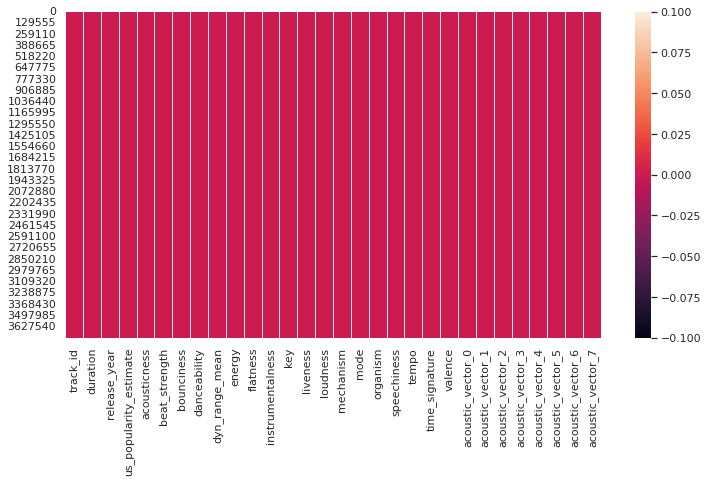

In [ ]:
plt.figure(figsize=(12, 6))
sns.heatmap(df.isnull())
plt.show()

 ***Check for Duplicates and getting rid of them***

In [ ]:
print(df[df.duplicated()])

                                       track_id  ...  acoustic_vector_7
3706388  t_a540e552-16d4-42f8-a185-232bd650ea7d  ...          -0.675907
3706389  t_67965da0-132b-4b1e-8a69-0ef99b32287c  ...          -0.525795
3706390  t_0614ecd3-a7d5-40a1-816e-156d5872a467  ...          -0.433496
3706391  t_070a63a0-744a-434e-9913-a97b02926a29  ...          -0.542753
3706392  t_d6990e17-9c31-4b01-8559-47d9ce476df1  ...          -0.455496
...                                         ...  ...                ...
3757087  t_402930af-4174-47ec-b1fd-593d93597624  ...          -0.192473
3757088  t_e5f9a069-a893-452e-ab21-49b4eaebfbd0  ...           0.384336
3757089  t_3983306d-13b4-4027-9391-7236ca93d2bf  ...           0.258766
3757090  t_74eb6e99-210b-440c-8d7b-4db6617d1c80  ...           0.143629
3757091  t_aec0dda3-19b4-4222-be07-327c12f21456  ...          -0.377302

[50704 rows x 30 columns]


In [ ]:
print(df.duplicated().sum())

50704


In [ ]:
print(df.duplicated().value_counts())

False    3706388
True       50704
dtype: int64


In [ ]:
print(df.drop_duplicates())

                                       track_id  ...  acoustic_vector_7
0        t_2e8f4b71-8a0b-4b9c-b7d8-fb5208e87f9f  ...          -0.227383
1        t_dae2ec0e-ec7b-4b3e-b60c-4a884d0eccb0  ...          -0.769024
2        t_cf0164dd-1531-4399-bfa6-dec19cd1fedc  ...          -0.172563
3        t_0f90acc7-d5c5-4e53-901d-55610fbd090c  ...          -0.016978
4        t_36b9ad02-095a-443d-a697-6c7285d9410a  ...          -0.446870
...                                         ...  ...                ...
3706383  t_8ca1c0cb-7140-482d-a51e-20c2d04dd826  ...           0.061174
3706384  t_0190990f-99f3-41a8-830f-6d1f09ea603d  ...           0.211413
3706385  t_9cf9f46e-2efd-4355-af00-2dfdcaf5b2a0  ...          -0.035709
3706386  t_7eed5c40-e59e-42b1-abff-81415c8c80f7  ...           0.104337
3706387  t_012fae69-a6e6-4018-91f3-51db8779982a  ...          -0.120936

[3706388 rows x 30 columns]


In [9]:
df.drop_duplicates(inplace=True)

In [ ]:
print(df.duplicated().sum())

0


***Release Year Analysis***

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


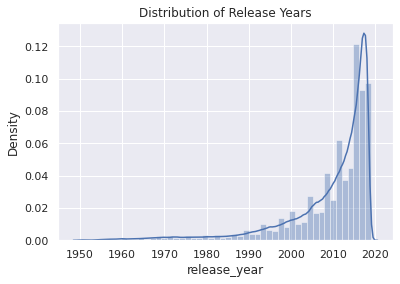

In [ ]:
sns.distplot(df.release_year)
plt.title("Distribution of Release Years");

***Key-Analysis***

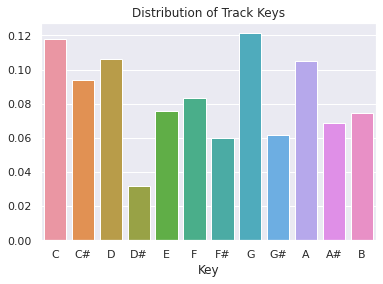

In [ ]:
# Key-mappings are from the dataset docs
# https://en.wikipedia.org/wiki/Pitch_class
keys = df.key.value_counts().sort_index()
sns.barplot(
    x=[
        "C",
        "C#",
        "D",
        "D#",
        "E",
        "F",
        "F#",
        "G",
        "G#",
        "A",
        "A#",
        "B"
    ],
    y=keys.values/keys.sum()
)
plt.title("Distribution of Track Keys")
plt.xlabel("Key");

In [ ]:
a= [c for c in df.columns if df[c].dtype == 'object']
a

['track_id', 'mode']

***Mode***

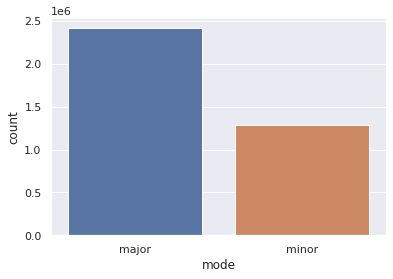

In [ ]:
sns.countplot(x='mode',data=df)

In [ ]:
df['mode'].value_counts()

major    2414637
minor    1291751
Name: mode, dtype: int64

In [ ]:
df['mode'].value_counts() / df['mode'].count()

major    0.65148
minor    0.34852
Name: mode, dtype: float64

In [8]:
df['mode'] = (df['mode'] == 'major').astype('int32')
df3['mode'] = (df3['mode'] == 'major').astype('int32')

In [13]:
df['mode'].value_counts()

1    2447192
0    1309900
Name: mode, dtype: int64

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3706388 entries, 0 to 3706387
Data columns (total 30 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   track_id                object 
 1   duration                float64
 2   release_year            int64  
 3   us_popularity_estimate  float64
 4   acousticness            float64
 5   beat_strength           float64
 6   bounciness              float64
 7   danceability            float64
 8   dyn_range_mean          float64
 9   energy                  float64
 10  flatness                float64
 11  instrumentalness        float64
 12  key                     int64  
 13  liveness                float64
 14  loudness                float64
 15  mechanism               float64
 16  mode                    int32  
 17  organism                float64
 18  speechiness             float64
 19  tempo                   float64
 20  time_signature          int64  
 21  valence                 float64

***Signature Analysis of track features***

In [ ]:
tf = df.time_signature.value_counts().sort_index()
tf / tf.sum()

0    0.000889
1    0.012131
3    0.105847
4    0.860257
5    0.020877
Name: time_signature, dtype: float64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


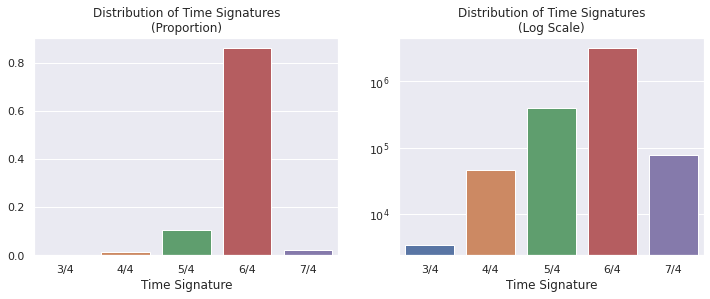

In [ ]:
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
sns.barplot(
    [f"{i}/4" for i in range(3,8)],
    tf.values / tf.sum()
)
plt.title("Distribution of Time Signatures\n(Proportion)")
plt.xlabel("Time Signature")

plt.subplot(1,2,2)
sns.barplot(
    [f"{i}/4" for i in range(3,8)],
    tf.values
)
plt.title("Distribution of Time Signatures\n(Log Scale)")
plt.xlabel("Time Signature")
plt.yscale('log');

# ***Pair Plot***

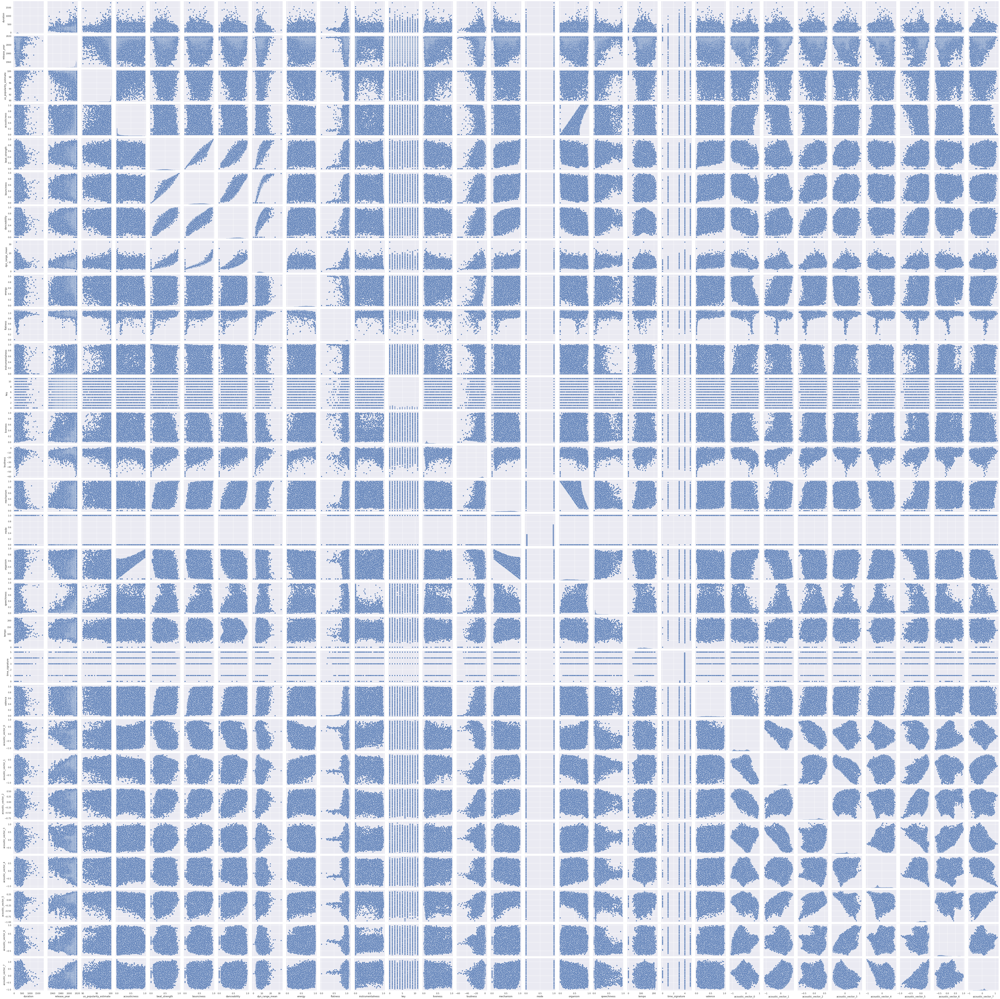

In [ ]:
sns.pairplot(
    df3
)
plt.savefig("/content/drive/MyDrive/Dataset_Technolab/PairPlot.png")

***Correlation Matrix for Acoustic Vectors***

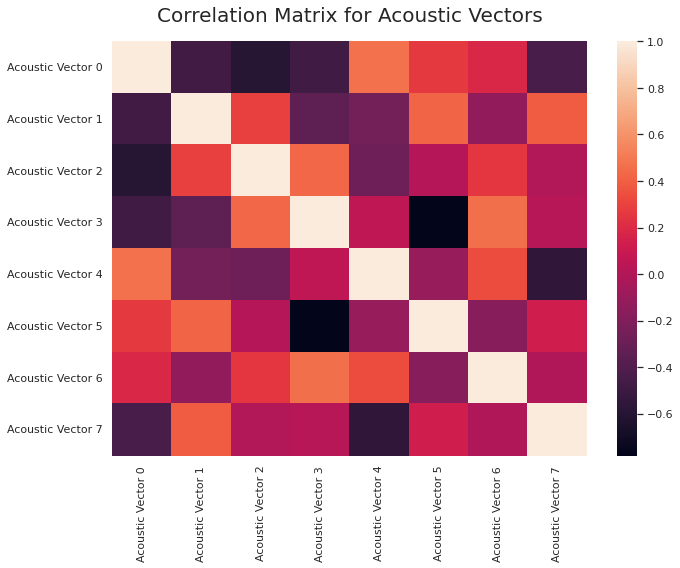

In [ ]:
plt.figure(figsize=(10,8))
sns.heatmap(
    df3[[
        "acoustic_vector_0",
        "acoustic_vector_1",
        "acoustic_vector_2",
        "acoustic_vector_3",
        "acoustic_vector_4",
        "acoustic_vector_5",
        "acoustic_vector_6",
        "acoustic_vector_7"
    ]].rename(
        columns={f"acoustic_vector_{i}":f"Acoustic Vector {i}" for i in range(8)}
    ).corr()
)
plt.title(
    "Correlation Matrix for Acoustic Vectors",
    fontsize=20,
    pad=20
)
plt.xlabel("")
plt.ylabel("")
plt.tight_layout()
plt.savefig("/content/drive/MyDrive/Dataset_Technolab/acoustic_vector_correlation.png")

***scatter_matrix***

<Figure size 432x288 with 0 Axes>

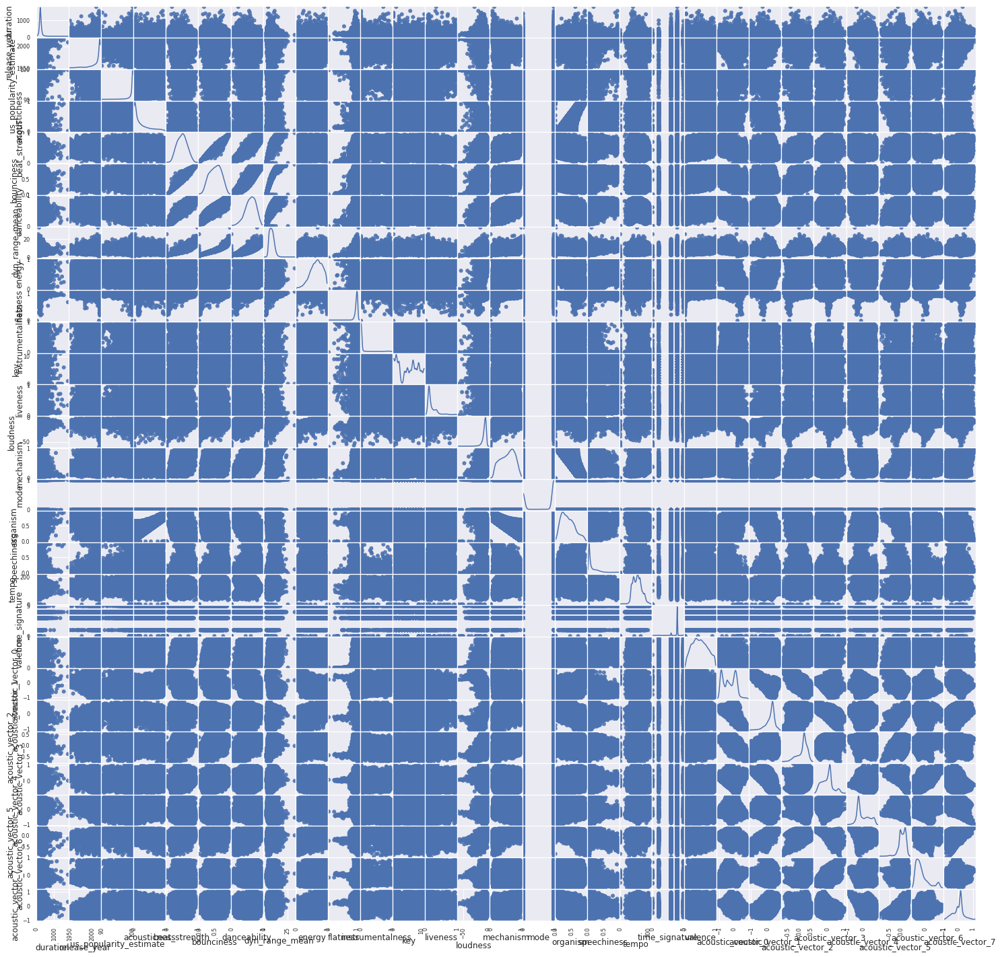

In [ ]:
from pandas.plotting import scatter_matrix
fig = plt.figure()
scatter_matrix(df3,figsize =(25,25),alpha=0.9,diagonal="kde",marker="o");
plt.savefig("/content/drive/MyDrive/Dataset_Technolab/scatter_matrix.png")

***Histogram***

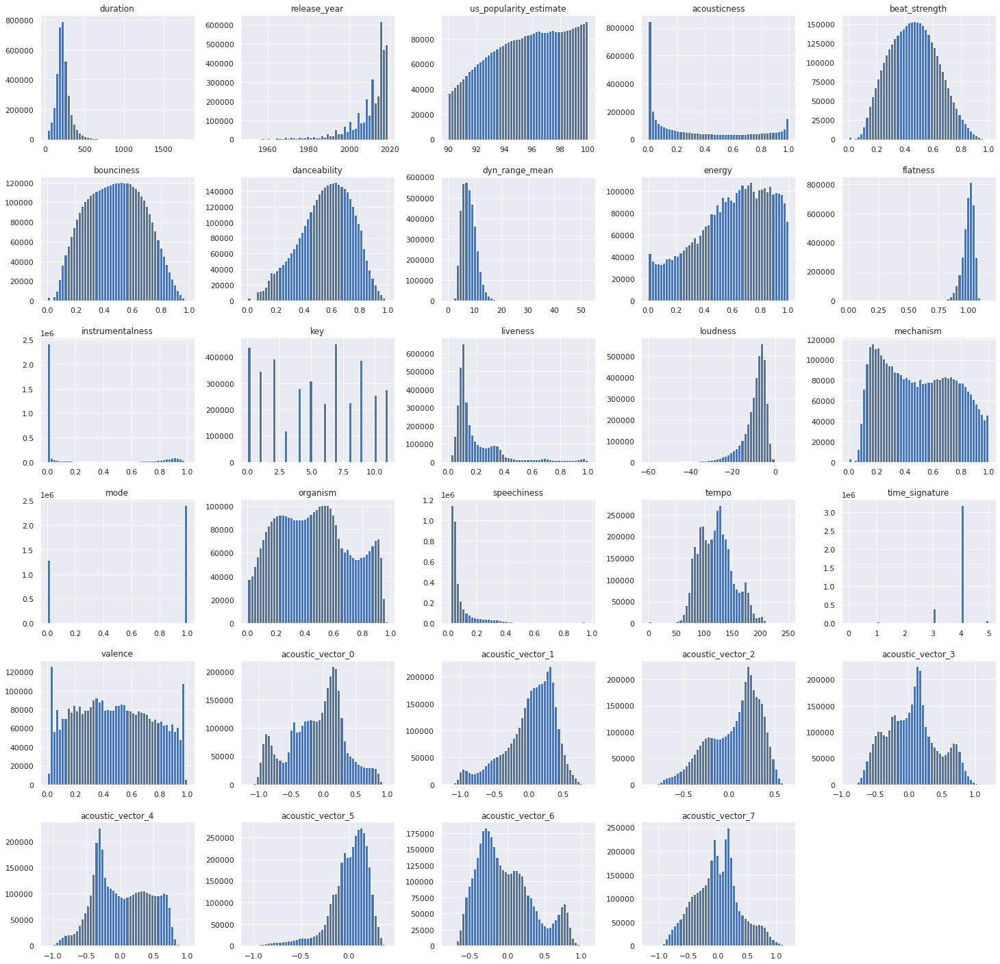

In [ ]:
df.hist(figsize=(25,25),bins=50)
plt.savefig("/content/drive/MyDrive/Dataset_Technolab/Hist_matrix.png")


***Correlation Matrix of track features***

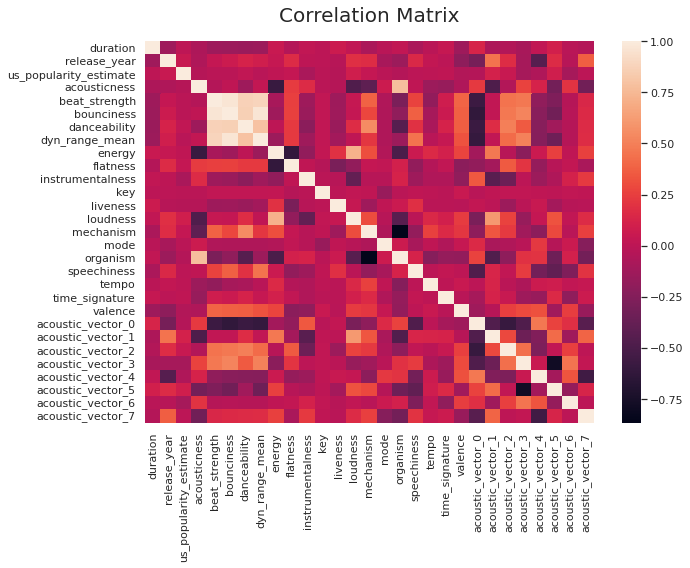

In [ ]:
plt.figure(figsize=(10,8))
sns.heatmap(
    df3.corr()
)
plt.title(
    "Correlation Matrix",
    fontsize=20,
    pad=20
)
plt.xlabel("")
plt.ylabel("")
plt.tight_layout()
plt.savefig("/content/drive/MyDrive/Dataset_Technolab/Features_correlation.png")

***Box Plot of all the features***

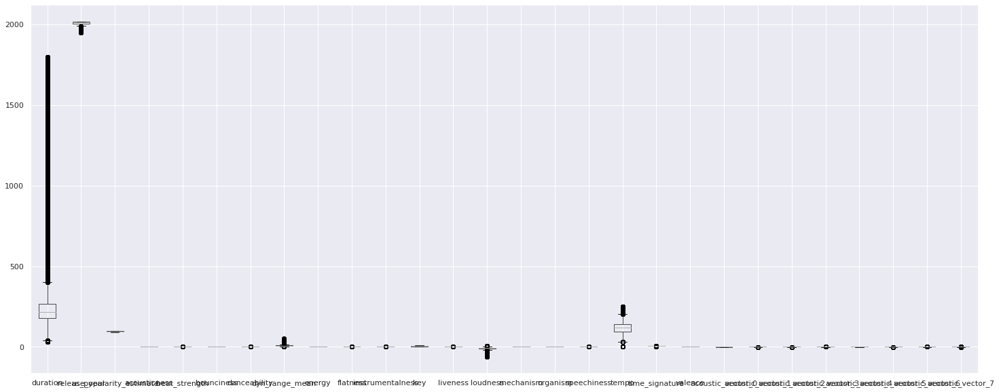

In [ ]:

df.boxplot(column=[c for c in df.columns if df[c].dtype  in  ['float64','int']], figsize = (25,10))
plt.savefig("/content/drive/MyDrive/Dataset_Technolab/Box_Plot.png")
          



***Checking for Covariance***

In [ ]:
from sklearn.feature_selection import VarianceThreshold
var_thres=VarianceThreshold(threshold=0)
var_thres.fit(df[[c for c in df.columns if df[c].dtype  in  ['float64','int']]])

VarianceThreshold(threshold=0)

In [ ]:
var_thres.get_support()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

# ***EDA on Training Log***

In [10]:
training_dir="/content/drive/MyDrive/Dataset_Technolab/training_set/"
train = pd.read_csv(training_dir+"log_0_20180715_000000000000.csv")

In [11]:
train

,session_id,session_position,session_length,track_id_clean,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,date,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,0,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,20,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,20,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,20,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,20,t_64f3743c-f624-46bb-a579-0f3f9a07a123,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2990604,0_ffffc3a8-e6fd-49a0-9bf9-2b464c14f769,16,20,t_7cfd4fc9-6811-41a2-8bea-daed723afc69,True,True,True,False,0,1,0,0,0,0,True,5,2018-07-15,True,user_collection,fwdbtn,backbtn
2990605,0_ffffc3a8-e6fd-49a0-9bf9-2b464c14f769,17,20,t_5c99f04b-47c6-4307-bb21-75b068b5d078,True,True,True,False,0,1,0,0,0,0,True,5,2018-07-15,True,user_collection,backbtn,fwdbtn
2990606,0_ffffc3a8-e6fd-49a0-9bf9-2b464c14f769,18,20,t_7cfd4fc9-6811-41a2-8bea-daed723afc69,True,True,True,False,0,1,0,0,0,0,True,5,2018-07-15,True,user_collection,fwdbtn,backbtn
2990607,0_ffffc3a8-e6fd-49a0-9bf9-2b464c14f769,19,20,t_5c99f04b-47c6-4307-bb21-75b068b5d078,False,False,True,False,0,1,0,0,4,0,True,5,2018-07-15,True,user_collection,backbtn,fwdbtn


In [12]:
df_joined = train.merge(df, how='left', left_on='track_id_clean', right_on='track_id')

In [13]:
df_joined

,session_id,session_position,session_length,track_id_clean,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,date,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,0,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,180.066666,2018,99.968133,0.015848,0.438551,0.473455,0.653119,7.660024,0.553465,1.035007,3.484468e-03,1,0.678553,-6.577,0.546784,major,0.320668,0.069717,134.024994,4,0.152255,-0.815775,0.386409,0.230160,0.028028,-0.333373,0.015452,-0.353590,0.205826
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,20,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,236.796371,2018,99.896728,0.061811,0.654804,0.735661,0.877393,11.308750,0.726828,1.025636,1.031315e-07,7,0.104322,-5.319,0.824766,minor,0.131391,0.061158,130.037994,4,0.337152,-0.713646,0.363718,0.310315,-0.042222,-0.383164,0.066357,-0.365308,0.157920
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,20,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,231.266663,2018,99.999976,0.354116,0.532155,0.540411,0.679719,8.065802,0.563009,1.029465,2.659035e-08,10,0.135776,-5.843,0.774327,major,0.296923,0.045354,145.028000,4,0.373862,-0.742541,0.375599,0.252660,-0.049007,-0.299745,0.063341,-0.486689,0.181604
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,20,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,169.826675,2018,99.995038,0.769225,0.641756,0.729224,0.864881,11.287586,0.529484,0.993520,6.598388e-06,1,0.103722,-7.756,0.630996,major,0.603271,0.229936,111.982002,4,0.649420,-0.705116,0.317562,0.289141,-0.038920,-0.393358,0.092719,-0.364418,0.285603
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,20,t_64f3743c-f624-46bb-a579-0f3f9a07a123,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_64f3743c-f624-46bb-a579-0f3f9a07a123,210.545258,2018,99.998498,0.006602,0.732428,0.794881,0.857778,12.181586,0.650057,1.000571,2.066649e-06,8,0.120842,-4.919,0.759465,major,0.170148,0.240980,147.031006,4,0.652921,-0.868489,0.331280,0.210478,0.084740,-0.333287,-0.025706,-0.510350,0.182315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2990604,0_ffffc3a8-e6fd-49a0-9bf9-2b464c14f769,16,20,t_7cfd4fc9-6811-41a2-8bea-daed723afc69,True,True,True,False,0,1,0,0,0,0,True,5,2018-07-15,True,user_collection,fwdbtn,backbtn,t_7cfd4fc9-6811-41a2-8bea-daed723afc69,124.250343,2017,99.965648,0.271854,0.480783,0.485689,0.673802,7.517185,0.636049,1.027599,1.623391e-02,9,0.104433,-5.829,0.871094,minor,0.212746,0.040303,142.988998,4,0.537843,-0.754337,0.282669,0.223824,0.081450,-0.280923,0.057794,-0.302068,0.285621
2990605,0_ffffc3a8-e6fd-49a0-9bf9-2b464c14f769,17,20,t_5c99f04b-47c6-4307-bb21-75b068b5d078,True,True,True,False,0,1,0,0,0,0,True,5,2018-07-15,True,user_collection,backbtn,fwdbtn,t_5c99f04b-47c6-4307-bb21-75b

In [19]:
df_joined.shape

(5289695, 51)

In [20]:
df_joined.describe()

,session_position,session_length,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hour_of_day,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
count,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06,5.289695e+06
mean,9.307957e+00,1.763084e+01,4.181942e-02,7.671259e-01,1.463152e-01,1.730646e-01,3.797175e-02,4.271173e-02,1.414539e+01,2.151711e+02,2.013867e+03,9.979854e+01,2.140425e-01,5.554247e-01,5.895068e-01,6.772036e-01,9.220702e+00,6.241771e-01,1.009962e+00,2.396785e-02,5.203895e+00,1.867031e-01,-6.945845e+00,6.024381e-01,6.068751e-01,3.427279e-01,1.451531e-01,1.227762e+02,3.954783e+00,4.543898e-01,-5.472995e-01,2.824318e-01,2.161309e-01,-1.434058e-02,-1.601448e-01,4.859543e-02,-2.969474e-01,6.941523e-02
std,5.449552e+00,3.411865e+00,2.001763e-01,4.226627e-01,3.534220e-01,3.783032e-01,3.435581e-01,5.345492e-01,6.031666e+00,5.785527e+01,9.242234e+00,8.372389e-01,2.405461e-01,1.553909e-01,1.746140e-01,1.553358e-01,2.510997e+00,1.765703e-01,3.694351e-02,1.223227e-01,3.692688e+00,1.449890e-01,2.976770e+00,2.039436e-01,4.884442e-01,1.844746e-01,1.324463e-01,2.976698e+01,3.211882e-01,2.249853e-01,3.692116e-01,1.770306e-01,1.545436e-01,2.539493e-01,2.959264e-01,1.110488e-01,2.892430e-01,2.482811e-01
min,1.000000e+00,1.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.001179e+01,1.950000e+03,9.000395e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-6.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-1.132921e+00,-1.118764e+00,-8.113571e-01,-8.687064e-01,-1.029858e+00,-9.862885e-01,-7.572944e-01,-9.921863e-01
25%,5.000000e+00,1.500000e+01,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.100000e+01,1.837048e+02,2.015000e+03,9.995507e+01,3.203240e-02,4.454665e-01,4.683871e-01,5.746594e-01,7.399426e+00,5.147702e-01,9.916327e-01,2.938060e-09,1.000000e+00,1.000372e-01,-8.150000e+00,4.670185e-01,0.000000e+00,2.044863e-01,4.592552e-02,9.699400e+01,4.000000e+00,2.783956e-01,-8.457326e-01,2.413325e-01,1.861329e-01,-1.592619e-01,-3.325246e-01,-2.920694e-02,-4.916404e-01,1.221366e-02
50%,9.000000e+00,2.000000e+01,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.500000e+01,2.116701e+02,2.017000e+03,9.999297e+01,1.153198e-01,5.567477e-01,6.016056e-01,6.968902e-01,9.053808e+00,6.257576e-01,1.015696e+00,3.881620e-07,5.000000e+00,1.244158e-01,-6.474000e+00,6.424051e-01,1.000000e+00,3.008752e-01,9.211845e-02,1.239940e+02,4.000000e+00,4.375930e-01,-6.919208e-01,3.178426e-01,2.387667e-01,4.678398e-02,-2.776575e-01,3.621011e-02,-3.901334e-01,1.454504e-01
75%,1.400000e+01,2.000000e+01,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.900000e+01,2.400392e+02,2.018000e+03,9.999897e+01,3.264359e-01,6.717522e-01,7.279553e-01,7.919306e-01,1.086321e+01,7.514511e-01,1.034536e+00,7.204217e-05,9.000000e+00,2.311746e-01,-5.077000e+00,7.603306e-01,1.000000e+00,4.621539e-01,2.130814e-01,1.442040e+02,4.000000e+00,6.172726e-01,-2.918536e-01,3.776334e-01,2

In [14]:
df_joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2990609 entries, 0 to 2990608
Data columns (total 51 columns):
 #   Column                           Dtype  
---  ------                           -----  
 0   session_id                       object 
 1   session_position                 int64  
 2   session_length                   int64  
 3   track_id_clean                   object 
 4   skip_1                           bool   
 5   skip_2                           bool   
 6   skip_3                           bool   
 7   not_skipped                      bool   
 8   context_switch                   int64  
 9   no_pause_before_play             int64  
 10  short_pause_before_play          int64  
 11  long_pause_before_play           int64  
 12  hist_user_behavior_n_seekfwd     int64  
 13  hist_user_behavior_n_seekback    int64  
 14  hist_user_behavior_is_shuffle    bool   
 15  hour_of_day                      int64  
 16  date                             object 
 17  premium 

In [15]:
df_joined.to_csv('joined_spotify.csv')

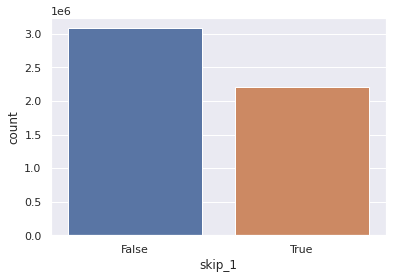

In [23]:
sns.countplot(x = 'skip_1', data = df_joined)

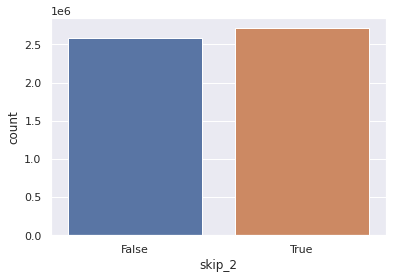

In [24]:
sns.countplot(x = 'skip_2', data = df_joined)

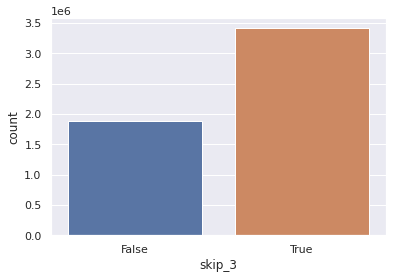

In [25]:
sns.countplot(x = 'skip_3',data = df_joined)

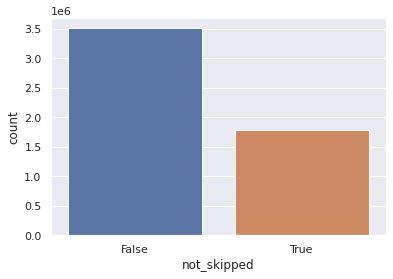

In [26]:
sns.countplot(x = 'not_skipped',data = df_joined)

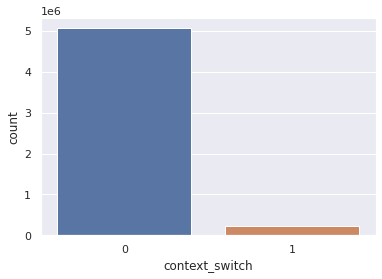

In [27]:
sns.countplot(x = 'context_switch',data = df_joined)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


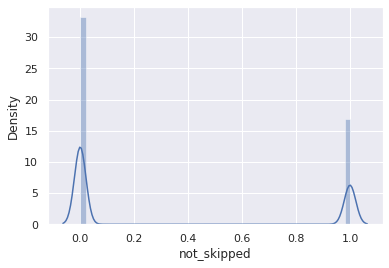

In [78]:
sns.distplot(df_joined['not_skipped'])

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


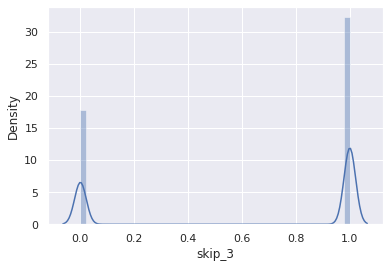

In [81]:
sns.distplot(df_joined['skip_3'])

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


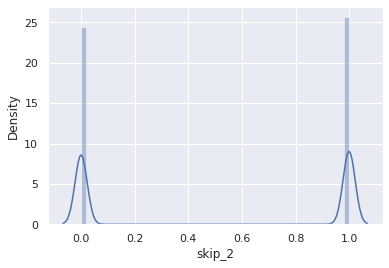

In [80]:
sns.distplot(df_joined['skip_2'])

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


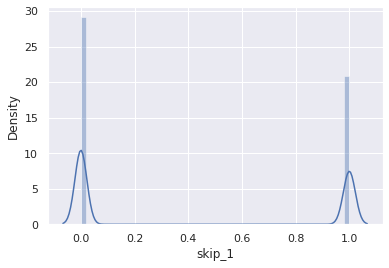

In [79]:
sns.distplot(df_joined['skip_1'])

In [28]:
df_joined.skew()

session_position                   0.252423
session_length                    -1.073495
skip_1                             0.335216
skip_2                            -0.050440
skip_3                            -0.607364
not_skipped                        0.693182
context_switch                     4.577771
no_pause_before_play              -1.264015
short_pause_before_play            2.001488
long_pause_before_play             1.728431
hist_user_behavior_n_seekfwd      80.485991
hist_user_behavior_n_seekback    321.173114
hist_user_behavior_is_shuffle      0.880771
hour_of_day                       -0.690571
premium                           -1.513842
duration                           2.020427
release_year                      -3.494140
us_popularity_estimate            -7.020365
acousticness                       1.339744
beat_strength                     -0.120202
bounciness                        -0.340415
danceability                      -0.547885
dyn_range_mean                  

In [29]:
df_joined.var()

session_position                   29.697618
session_length                     11.640826
skip_1                              0.243169
skip_2                              0.249841
skip_3                              0.228891
not_skipped                         0.223189
context_switch                      0.040071
no_pause_before_play                0.178644
short_pause_before_play             0.124907
long_pause_before_play              0.143113
hist_user_behavior_n_seekfwd        0.118032
hist_user_behavior_n_seekback       0.285743
hist_user_behavior_is_shuffle       0.209391
hour_of_day                        36.380996
premium                             0.158939
duration                         3347.231942
release_year                       85.418893
us_popularity_estimate              0.700969
acousticness                        0.057862
beat_strength                       0.024146
bounciness                          0.030490
danceability                        0.024129
dyn_range_

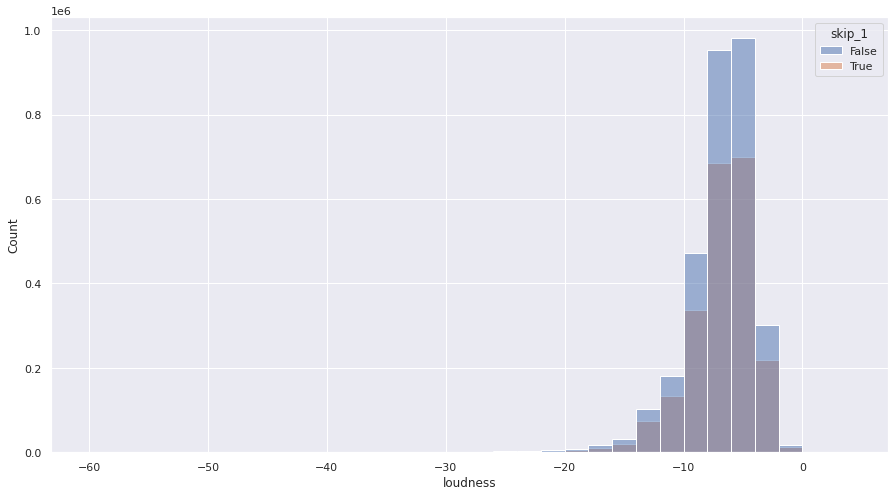

In [30]:
ax = plt.subplots(figsize=(15, 8))
sns.histplot(x='loudness',hue='skip_1', data=df_joined, binwidth=2)

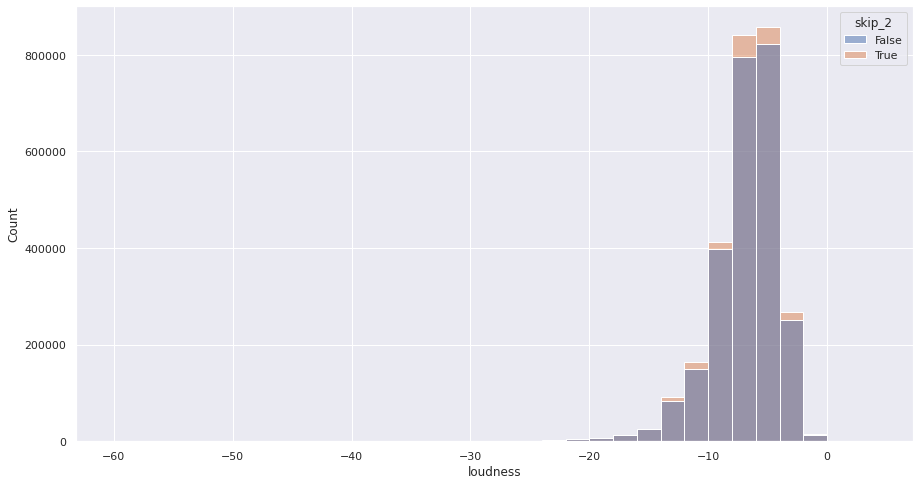

In [31]:
ax = plt.subplots(figsize=(15, 8))
sns.histplot(x='loudness',hue='skip_2', data=df_joined, binwidth=2)

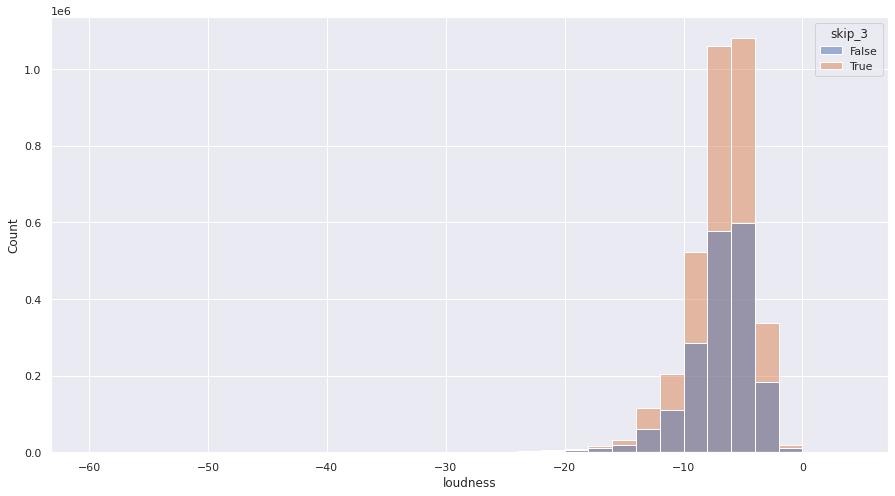

In [32]:
ax = plt.subplots(figsize=(15, 8))
sns.histplot(x='loudness',hue='skip_3', data=df_joined, binwidth=2)

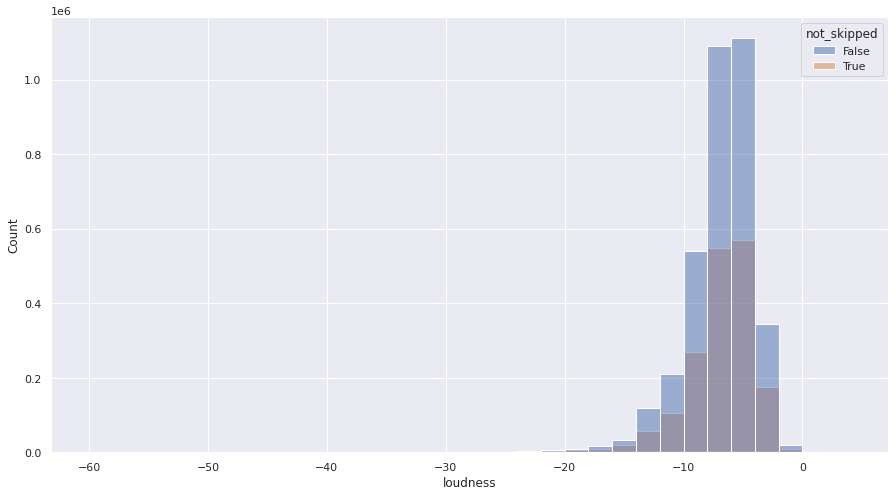

In [33]:
ax = plt.subplots(figsize=(15, 8))
sns.histplot(x='loudness',hue='not_skipped', data=df_joined, binwidth=2)

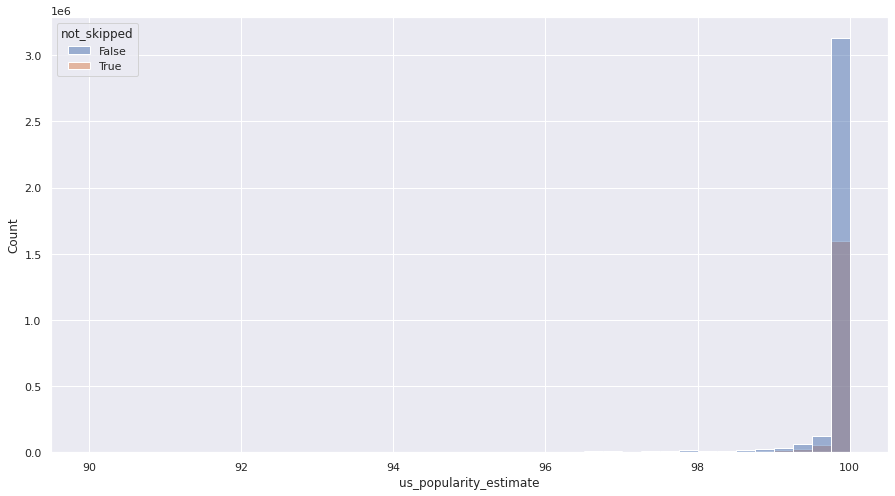

In [34]:
ax = plt.subplots(figsize=(15, 8))
sns.histplot(x='us_popularity_estimate',hue='not_skipped', data=df_joined, binwidth=0.25)

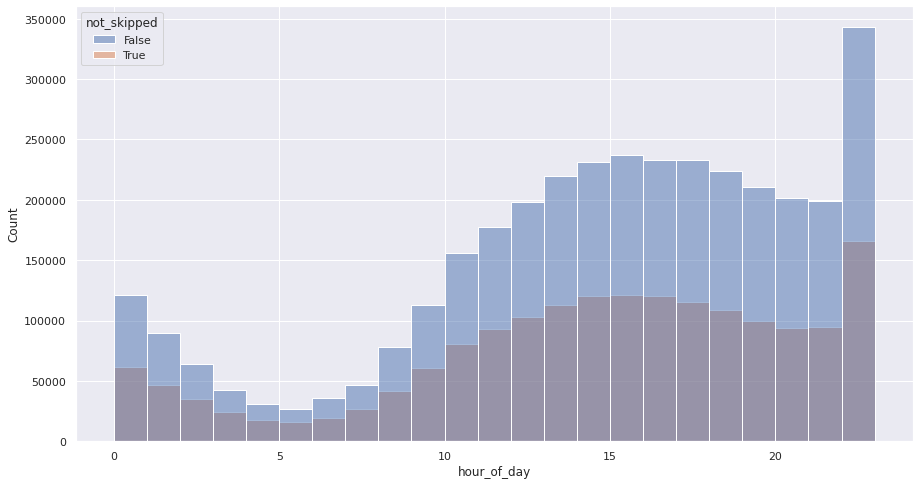

In [35]:
ax = plt.subplots(figsize=(15, 8))
sns.histplot(x='hour_of_day',hue='not_skipped', data=df_joined, binwidth=1)

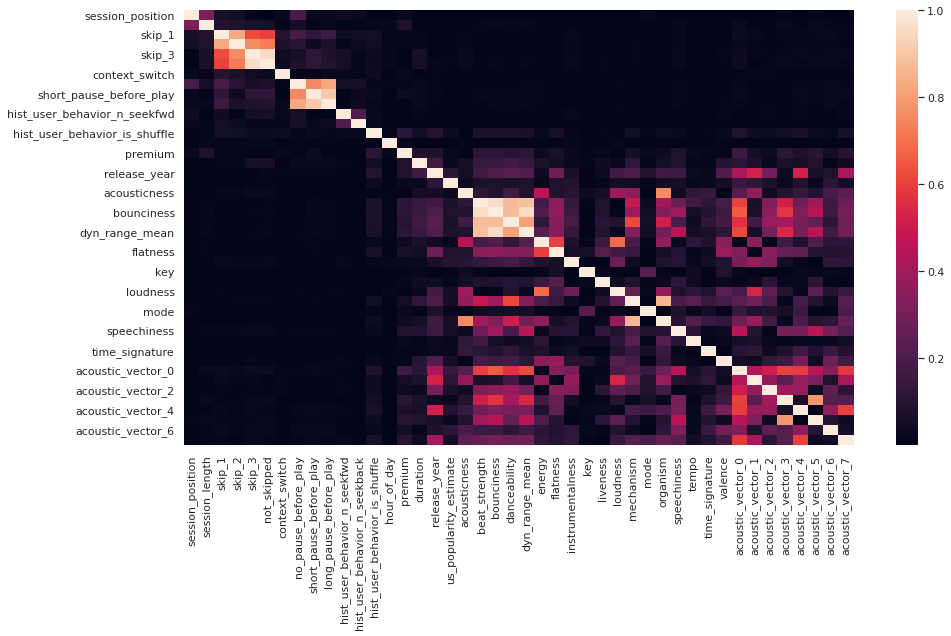

In [36]:
ax = plt.subplots(figsize=(15, 8))
sns.heatmap(data=df_joined.corr().abs())

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


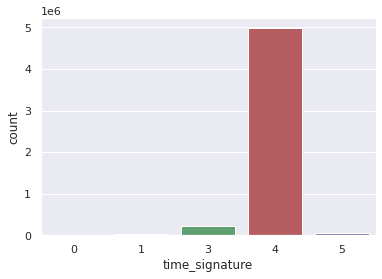

In [37]:
sns.countplot(df_joined.time_signature)

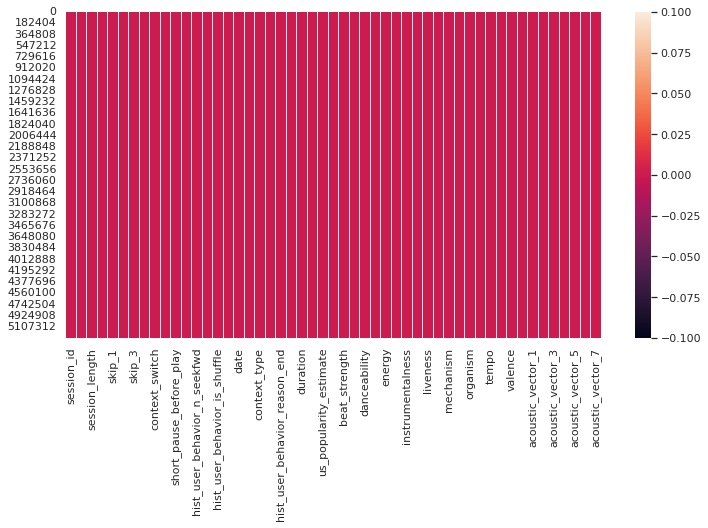

In [39]:
plt.figure(figsize=(12, 6))
sns.heatmap(df_joined.isnull())
plt.show()

In [41]:
target_cols = ['skip_1', "skip_2", "skip_3", "not_skipped"]
sizes = []
for col in target_cols:
  sizes.append(len(df_joined[df_joined[col] == 0]))


colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral']

explode = (0, 0, 0.1, 0)  # explode 1st slice



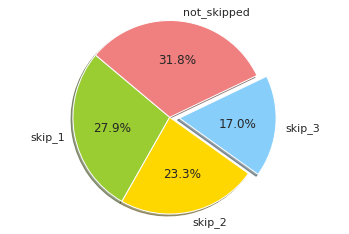

In [42]:
colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral']

explode = (0, 0, 0.1, 0)  # explode 1st slice

plt.pie(sizes, explode=explode, labels=target_cols, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)

plt.axis('equal')
plt.show()

In [47]:
Num =[c for c in df_joined.columns if df_joined[c].dtype  in  ['float64','int']]
Cat=[c for c in df_joined.columns if df_joined[c].dtype== "object"]

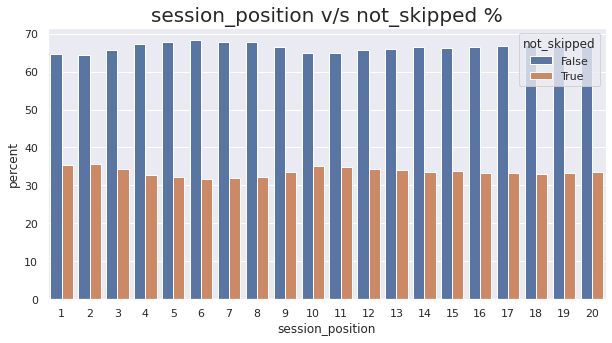

In [57]:
x,y = 'session_position', 'not_skipped'
plt.figure(figsize=(10, 5))

data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()
#.pipe((sns.catplot,'data'), x=x,y='percent',hue=y,kind='bar')    # alternate of barplot 
)

sns.barplot(x=x, y='percent',hue=y, data=data)
plt.title(x+' v/s '+y+' %', size=20)
plt.show()

Text(0.5, 1.0, 'session_length v/s not_skipped %')

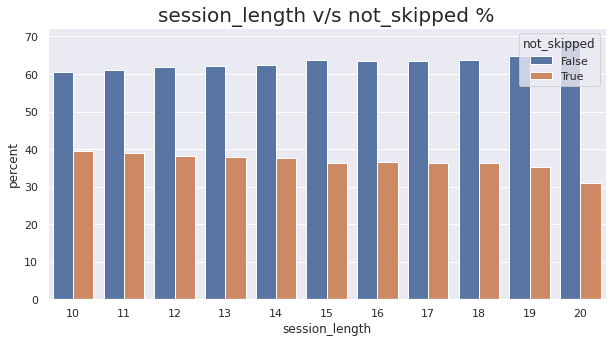

In [59]:
x,y = 'session_length', 'not_skipped'
plt.figure(figsize=(10, 5))

data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()  )

sns.barplot(x=x, y='percent',hue=y, data=data)
plt.title(x+' v/s '+y+' %', size=20)

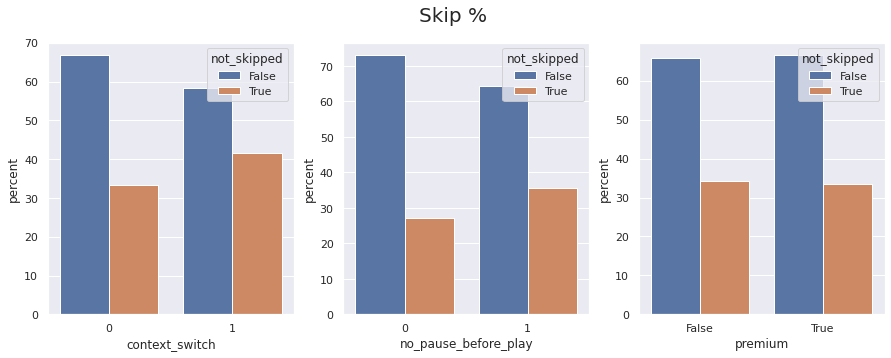

In [60]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5), gridspec_kw={'width_ratios': [1, 1, 1]})
fig.suptitle('Skip %', fontsize = 20)

x,y = 'context_switch', 'not_skipped'
data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()  )
sns.barplot(ax=axes[0], x=x, y='percent',hue=y, data=data)

x,y = 'no_pause_before_play', 'not_skipped'
data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()  )
sns.barplot(ax=axes[1], x=x, y='percent',hue=y, data=data)

x,y = 'premium', 'not_skipped'
data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()  )
sns.barplot(ax=axes[2], x=x, y='percent',hue=y, data=data)

plt.show()

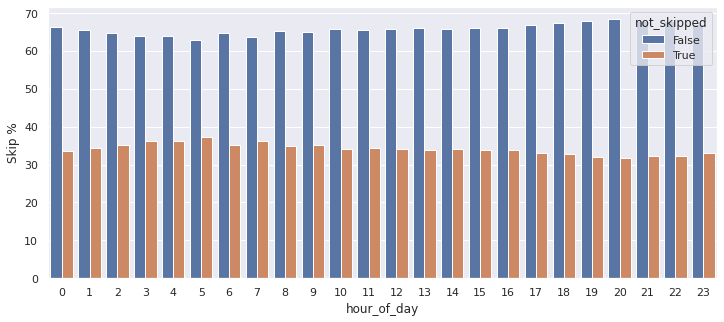

In [64]:
plt.figure(figsize=(12,5))
x,y = 'hour_of_day', 'not_skipped'
data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('Skip %')
.reset_index()  )
sns.barplot(x=x, y='Skip %',hue=y, data=data)

plt.show()

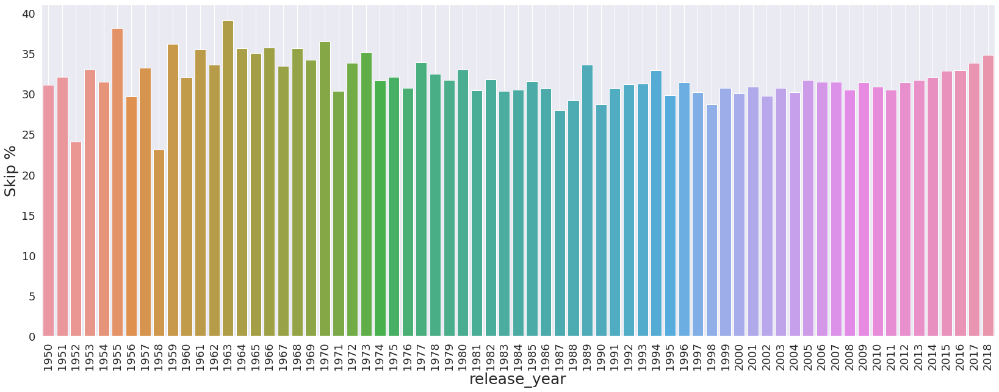

In [66]:
x,y = 'release_year', 'not_skipped'
plt.figure(figsize=(28, 10))

data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('Skip %')
.reset_index()  )

sns.barplot(x=x, y='Skip %',data=data[data.not_skipped == 1])
plt.xticks(rotation=90, fontsize=18), plt.yticks(fontsize=18)
plt.xlabel(x, fontsize=25), plt.ylabel('Skip %', fontsize=25)
plt.grid()
plt.show()

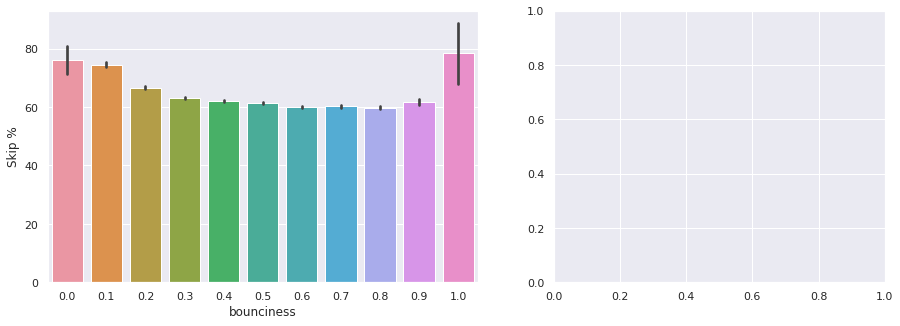

In [71]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5), gridspec_kw={'width_ratios': [1.3, 1]})

x,y = 'bounciness', 'not_skipped'
data=(df_joined
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('Skip %')
.reset_index()  )
data.bounciness = data.bounciness.round(1)
sns.barplot(ax=axes[0], x=x, y='Skip %',data=data[data.not_skipped == 1])



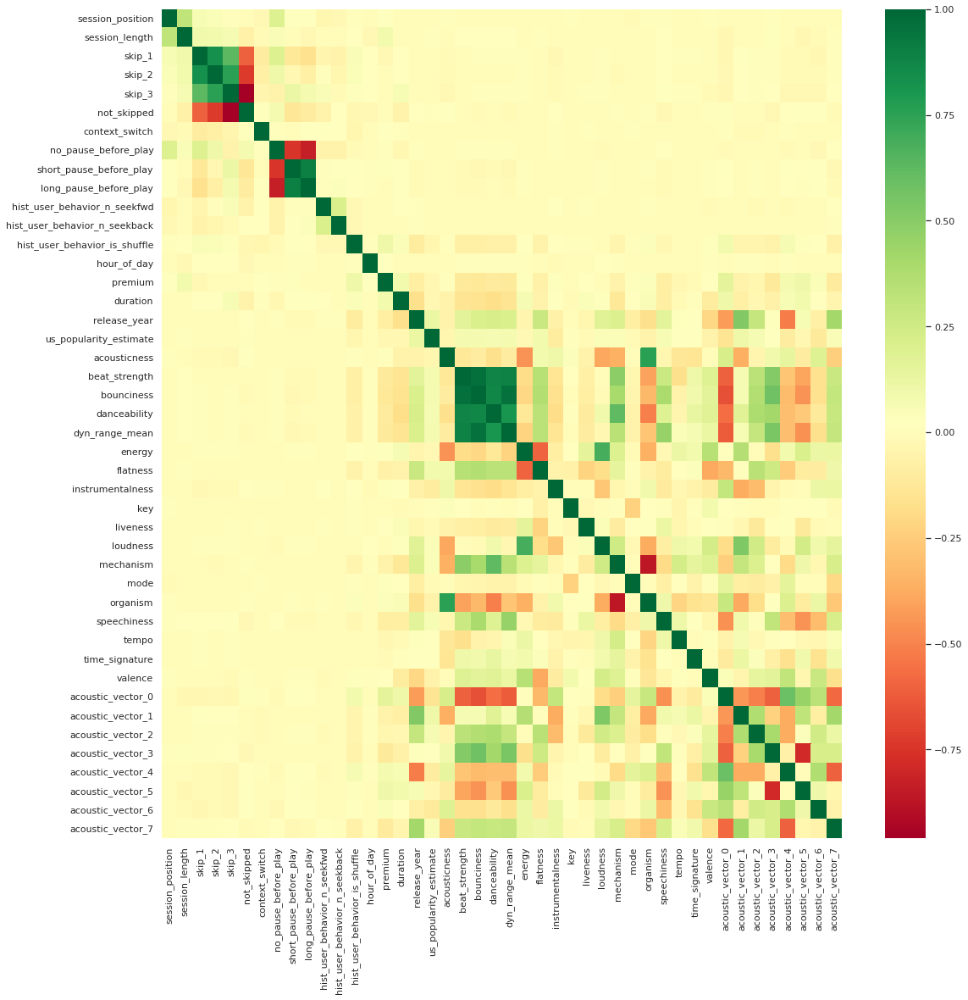

In [75]:
plt.figure(figsize = (18,18))
sns.heatmap(df_joined.corr(), cmap = "RdYlGn")
plt.show()

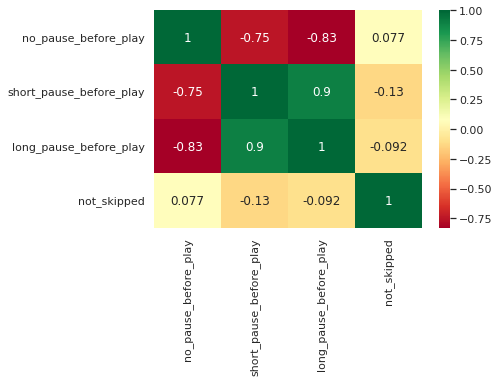

In [76]:
sns.heatmap(df_joined[['no_pause_before_play', 'short_pause_before_play', 
                               'long_pause_before_play', 'not_skipped']].corr(),annot = True, cmap = "RdYlGn")
plt.show()

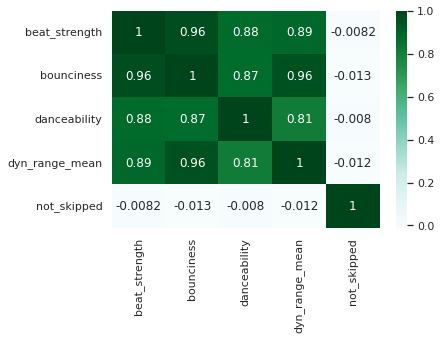

In [77]:
sns.heatmap(df_joined[['beat_strength', 'bounciness', 'danceability', 
                               'dyn_range_mean', 'not_skipped']].corr(),annot = True, cmap = "BuGn")
plt.show()

# ***Data Pre-Pocessing***

In [13]:
df_joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2990609 entries, 0 to 2990608
Data columns (total 51 columns):
 #   Column                           Dtype  
---  ------                           -----  
 0   session_id                       object 
 1   session_position                 int64  
 2   session_length                   int64  
 3   track_id_clean                   object 
 4   skip_1                           bool   
 5   skip_2                           bool   
 6   skip_3                           bool   
 7   not_skipped                      bool   
 8   context_switch                   int64  
 9   no_pause_before_play             int64  
 10  short_pause_before_play          int64  
 11  long_pause_before_play           int64  
 12  hist_user_behavior_n_seekfwd     int64  
 13  hist_user_behavior_n_seekback    int64  
 14  hist_user_behavior_is_shuffle    bool   
 15  hour_of_day                      int64  
 16  date                             object 
 17  premium 

In [14]:
df_joined.head()

,session_id,session_position,session_length,track_id_clean,skip_1,skip_2,skip_3,not_skipped,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,date,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end,track_id,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7
0,0_00006f66-33e5-4de7-a324-2d18e439fc1e,1,20,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,False,False,False,True,0,0,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_0479f24c-27d2-46d6-a00c-7ec928f2b539,180.066666,2018,99.968133,0.015848,0.438551,0.473455,0.653119,7.660024,0.553465,1.035007,3.484468e-03,1,0.678553,-6.577,0.546784,1,0.320668,0.069717,134.024994,4,0.152255,-0.815775,0.386409,0.230160,0.028028,-0.333373,0.015452,-0.353590,0.205826
1,0_00006f66-33e5-4de7-a324-2d18e439fc1e,2,20,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_9099cd7b-c238-47b7-9381-f23f2c1d1043,236.796371,2018,99.896728,0.061811,0.654804,0.735661,0.877393,11.308750,0.726828,1.025636,1.031315e-07,7,0.104322,-5.319,0.824766,0,0.131391,0.061158,130.037994,4,0.337152,-0.713646,0.363718,0.310315,-0.042222,-0.383164,0.066357,-0.365308,0.157920
2,0_00006f66-33e5-4de7-a324-2d18e439fc1e,3,20,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_fc5df5ba-5396-49a7-8b29-35d0d28249e0,231.266663,2018,99.999976,0.354116,0.532155,0.540411,0.679719,8.065802,0.563009,1.029465,2.659035e-08,10,0.135776,-5.843,0.774327,1,0.296923,0.045354,145.028000,4,0.373862,-0.742541,0.375599,0.252660,-0.049007,-0.299745,0.063341,-0.486689,0.181604
3,0_00006f66-33e5-4de7-a324-2d18e439fc1e,4,20,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_23cff8d6-d874-4b20-83dc-94e450e8aa20,169.826675,2018,99.995038,0.769225,0.641756,0.729224,0.864881,11.287586,0.529484,0.993520,6.598388e-06,1,0.103722,-7.756,0.630996,1,0.603271,0.229936,111.982002,4,0.649420,-0.705116,0.317562,0.289141,-0.038920,-0.393358,0.092719,-0.364418,0.285603
4,0_00006f66-33e5-4de7-a324-2d18e439fc1e,5,20,t_64f3743c-f624-46bb-a579-0f3f9a07a123,False,False,False,True,0,1,0,0,0,0,True,16,2018-07-15,True,editorial_playlist,trackdone,trackdone,t_64f3743c-f624-46bb-a579-0f3f9a07a123,210.545258,2018,99.998498,0.006602,0.732428,0.794881,0.857778,12.181586,0.650057,1.000571,2.066649e-06,8,0.120842,-4.919,0.759465,1,0.170148,0.240980,147.031006,4,0.652921,-0.868489,0.331280,0.210478,0.084740,-0.333287,-0.025706,-0.510350,0.182315


In [15]:
df_joined['context_type'].unique()

array(['editorial_playlist', 'user_collection', 'radio',
       'personalized_playlist', 'catalog', 'charts'], dtype=object)

In [16]:
df_joined['hist_user_behavior_reason_start'].unique()

array(['trackdone', 'fwdbtn', 'backbtn', 'clickrow', 'appload', 'playbtn',
       'remote', 'trackerror', 'endplay', 'popup', 'uriopen'],
      dtype=object)

In [16]:
# -- DATA SMOOTHING: Reassigning session id to a clearer naming convention -- #
data = df_joined
new_session_id = []
session_num = 0

data["prev_id"] = data["session_id"].shift(1)

for row in data.itertuples():
    if row.session_id == row.prev_id:
        new_session_id.append(session_num)
    elif row.session_id != row.prev_id:
        session_num+=1
        new_session_id.append(session_num)

data["new_session_id"] = new_session_id

#cols = ["new_session_id"] + [col for col in session if col!="new_session_id"]

#session = session[cols]


# -- DATA SMOOTHING: Encoding track_id to numeric digits -- #
data["track_id_clean"] = data["track_id_clean"].astype('category')
data["track_id_enc"] = data["track_id_clean"].cat.codes


del data["prev_id"]
del data["session_id"]
del data["track_id_clean"]

columnTitles = ['new_session_id', 'session_position', 'session_length', 'track_id_enc', 
                'skip_1', 'skip_2', 'skip_3', 'not_skipped', 'context_switch', 
               'no_pause_before_play', 'short_pause_before_play', 'long_pause_before_play', 
               'hist_user_behavior_n_seekfwd', 'hist_user_behavior_n_seekback', 
               'hist_user_behavior_is_shuffle', 'hour_of_day', 'date', 'premium', 'context_type',
               'hist_user_behavior_reason_start', 'hist_user_behavior_reason_end']

data = data.reindex(columns=columnTitles)

In [17]:
data.skip_2 = data.skip_2.astype(int)
data.hist_user_behavior_is_shuffle = data.hist_user_behavior_is_shuffle.astype(int)
data.premium = data.premium.astype(int)

In [18]:
scaler = preprocessing.MinMaxScaler()

cols_to_norm = ["us_popularity_estimate","acousticness", "beat_strength", "bounciness", 
      "danceability", "dyn_range_mean", "energy", "flatness",
      "instrumentalness", "key", "liveness", "loudness", 
      "mechanism", "organism", "speechiness", "tempo",
      "time_signature", "valence", "acoustic_vector_0",
      "acoustic_vector_1", "acoustic_vector_2", "acoustic_vector_3",
      "acoustic_vector_4", "acoustic_vector_5", "acoustic_vector_6",
      "acoustic_vector_7"]

df_joined[cols_to_norm] = scaler.fit_transform(df_joined[cols_to_norm])  

In [19]:
df_joined["track_id"] = df_joined["track_id"].astype('category')
df_joined["track_id_enc"] = df_joined["track_id"].cat.codes

cols = ["track_id_enc"] + [col for col in df_joined if col!="track_id_enc"]

df_joined = df_joined[cols]

del df_joined["track_id"]

In [20]:
final_data = df_joined.drop(columns = ['skip_1', 'skip_3', 'not_skipped', 'date'], axis = 1)

In [21]:
final_data["context_type"] = final_data["context_type"].astype('category')
c = final_data["context_type"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["context_type"] = final_data["context_type"].cat.codes

{0: 'catalog', 1: 'charts', 2: 'editorial_playlist', 3: 'personalized_playlist', 4: 'radio', 5: 'user_collection'}


In [22]:
final_data["hist_user_behavior_reason_start"] = final_data["hist_user_behavior_reason_start"].astype('category')
c = final_data["hist_user_behavior_reason_start"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["hist_user_behavior_reason_start"] = final_data["hist_user_behavior_reason_start"].cat.codes

{0: 'appload', 1: 'backbtn', 2: 'clickrow', 3: 'endplay', 4: 'fwdbtn', 5: 'playbtn', 6: 'popup', 7: 'remote', 8: 'trackdone', 9: 'trackerror', 10: 'uriopen'}


In [23]:
final_data["hist_user_behavior_reason_end"] = final_data["hist_user_behavior_reason_end"].astype('category')
c = final_data["hist_user_behavior_reason_end"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["hist_user_behavior_reason_end"] = final_data["hist_user_behavior_reason_end"].cat.codes

{0: 'appload', 1: 'backbtn', 2: 'clickrow', 3: 'endplay', 4: 'fwdbtn', 5: 'logout', 6: 'popup', 7: 'remote', 8: 'trackdone', 9: 'uriopen'}


In [24]:
final_data["mode"] = final_data["mode"].astype('category')
c = final_data["mode"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["mode"] = final_data["mode"].cat.codes

{0: 'major', 1: 'minor'}


In [25]:
final_data["skip_2"] = final_data["skip_2"].astype('category')
c = final_data["skip_2"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["skip_2"] = final_data["skip_2"].cat.codes

{0: False, 1: True}


In [26]:
final_data["hist_user_behavior_is_shuffle"] = final_data["hist_user_behavior_is_shuffle"].astype('category')
c = final_data["hist_user_behavior_is_shuffle"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["hist_user_behavior_is_shuffle"] = final_data["hist_user_behavior_is_shuffle"].cat.codes

{0: False, 1: True}


In [27]:
final_data["premium"] = final_data["premium"].astype('category')
c = final_data["premium"].astype('category')
d = dict(enumerate(c.cat.categories))
print (d)
final_data["premium"] = final_data["premium"].cat.codes

{0: False, 1: True}


In [28]:
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2990609 entries, 0 to 2990608
Data columns (total 46 columns):
 #   Column                           Dtype  
---  ------                           -----  
 0   track_id_enc                     int32  
 1   session_position                 int64  
 2   session_length                   int64  
 3   skip_2                           int8   
 4   context_switch                   int64  
 5   no_pause_before_play             int64  
 6   short_pause_before_play          int64  
 7   long_pause_before_play           int64  
 8   hist_user_behavior_n_seekfwd     int64  
 9   hist_user_behavior_n_seekback    int64  
 10  hist_user_behavior_is_shuffle    int8   
 11  hour_of_day                      int64  
 12  premium                          int8   
 13  context_type                     int8   
 14  hist_user_behavior_reason_start  int8   
 15  hist_user_behavior_reason_end    int8   
 16  duration                         float64
 17  release_

In [29]:
final_data.sort_values(['new_session_id','session_position'],inplace=True)

In [30]:
final_data = final_data.reset_index()

In [31]:
first_half = final_data.loc[lambda x: x.session_position <= (x.session_length/2)].copy()
second_half = final_data.loc[lambda x: x.session_position > (x.session_length/2)].copy()

In [32]:
left_skewed = ['acoustic_vector_1', 'acoustic_vector_2', 'acoustic_vector_5', 'loudness'] # Exp
right_skewed = ['acousticness', 'instrumentalness', 'liveness', 'speechiness'] # log 

In [33]:
import math
def exponential(x):
  return float(math.exp(x))

def logarithm(x):
  return math.log(x+1)

for col in left_skewed:
  final_data[col].apply(exponential)

for col in right_skewed:
  final_data[col].apply(logarithm)

In [34]:
# Normalisation
scaler = preprocessing.MinMaxScaler()

cols_to_norm = ["us_popularity_estimate","acousticness", "beat_strength", "bounciness", 
      "danceability", "dyn_range_mean", "energy", "flatness",
      "instrumentalness", "key", "liveness", "loudness", 
      "mechanism", "organism", "speechiness", "tempo",
      "time_signature", "valence", "acoustic_vector_0",
      "acoustic_vector_1", "acoustic_vector_2", "acoustic_vector_3",
      "acoustic_vector_4", "acoustic_vector_5", "acoustic_vector_6",
      "acoustic_vector_7"]

final_data[cols_to_norm] = scaler.fit_transform(final_data[cols_to_norm])  

In [35]:
final_data.describe()

,index,track_id_enc,session_position,session_length,skip_2,context_switch,no_pause_before_play,short_pause_before_play,long_pause_before_play,hist_user_behavior_n_seekfwd,hist_user_behavior_n_seekback,hist_user_behavior_is_shuffle,hour_of_day,premium,context_type,hist_user_behavior_reason_start,hist_user_behavior_reason_end,duration,release_year,us_popularity_estimate,acousticness,beat_strength,bounciness,danceability,dyn_range_mean,energy,flatness,instrumentalness,key,liveness,loudness,mechanism,mode,organism,speechiness,tempo,time_signature,valence,acoustic_vector_0,acoustic_vector_1,acoustic_vector_2,acoustic_vector_3,acoustic_vector_4,acoustic_vector_5,acoustic_vector_6,acoustic_vector_7,new_session_id
count,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06,2.990609e+06
mean,1.495304e+06,1.613297e+05,9.312991e+00,1.762598e+01,5.127504e-01,4.242681e-02,7.666128e-01,1.473198e-01,1.737532e-01,3.958525e-02,4.301465e-02,3.030878e-01,1.413181e+01,8.088767e-01,3.014478e+00,4.852421e+00,5.080195e+00,2.160286e+02,2.013451e+03,9.739991e-01,2.204785e-01,5.521474e-01,5.957687e-01,6.709589e-01,2.381519e-01,6.263900e-01,8.947096e-01,3.111973e-02,4.738518e-01,1.893954e-01,8.323230e-01,5.949790e-01,3.886439e-01,3.598943e-01,1.474583e-01,5.023165e-01,7.897270e-01,4.582423e-01,2.932701e-01,7.150781e-01,7.125435e-01,4.174214e-01,4.405266e-01,7.473188e-01,2.684807e-01,4.887907e-01,8.918187e+04
std,8.633146e+05,9.091299e+04,5.449092e+00,3.414523e+00,4.998375e-01,2.015609e-01,4.229866e-01,3.544245e-01,3.788972e-01,3.620769e-01,5.537631e-01,4.595929e-01,6.036343e+00,3.931860e-01,2.011643e+00,2.428195e+00,2.277814e+00,6.016175e+01,9.545819e+00,9.053328e-02,2.477954e-01,1.591355e-01,1.829354e-01,1.596098e-01,6.620665e-02,1.819857e-01,3.450820e-02,1.414235e-01,3.347522e-01,1.500988e-01,4.944920e-02,2.080131e-01,4.874422e-01,1.945684e-01,1.381536e-01,1.221423e-01,6.736986e-02,2.283061e-01,1.829454e-01,9.887365e-02,1.168728e-01,1.306034e-01,1.544138e-01,8.437682e-02,1.701562e-01,1.205585e-01,5.147737e+04
min,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.001179e+01,1.950000e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
25%,7.476520e+05,8.330700e+04,5.000000e+00,1.500000e+01,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.100000e+01,1.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00,1.836179e+02,2.015000e+03,9.914669e-01,3.138184e-02,4.380158e-01,4.649934e-01,5.645443e-01,1.895209e-01,5.139499e-01,8.779877e-01,3.510981e-09,9.090909e-02,9.966141e-02,8.135263e-01,4.505119e-01,0.000000e+00,2.117593e-01,4.644585e-02,3.974512e-01,8.000000e-01,2.799054e-01,1.391461e-01,6.923672e-01,6.912642e-01,3.421430e-01,3.471939e-01,6.909308e-01,1.512245e-01,4.515757e-01,4.460200e+04
50%,1.495304e+06,1.616950e+05,9.000000e+00,2.000000e+01,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.500000e+01,1.000000e+00,4.000000e+00,4.00000

# ***Feature Selection***

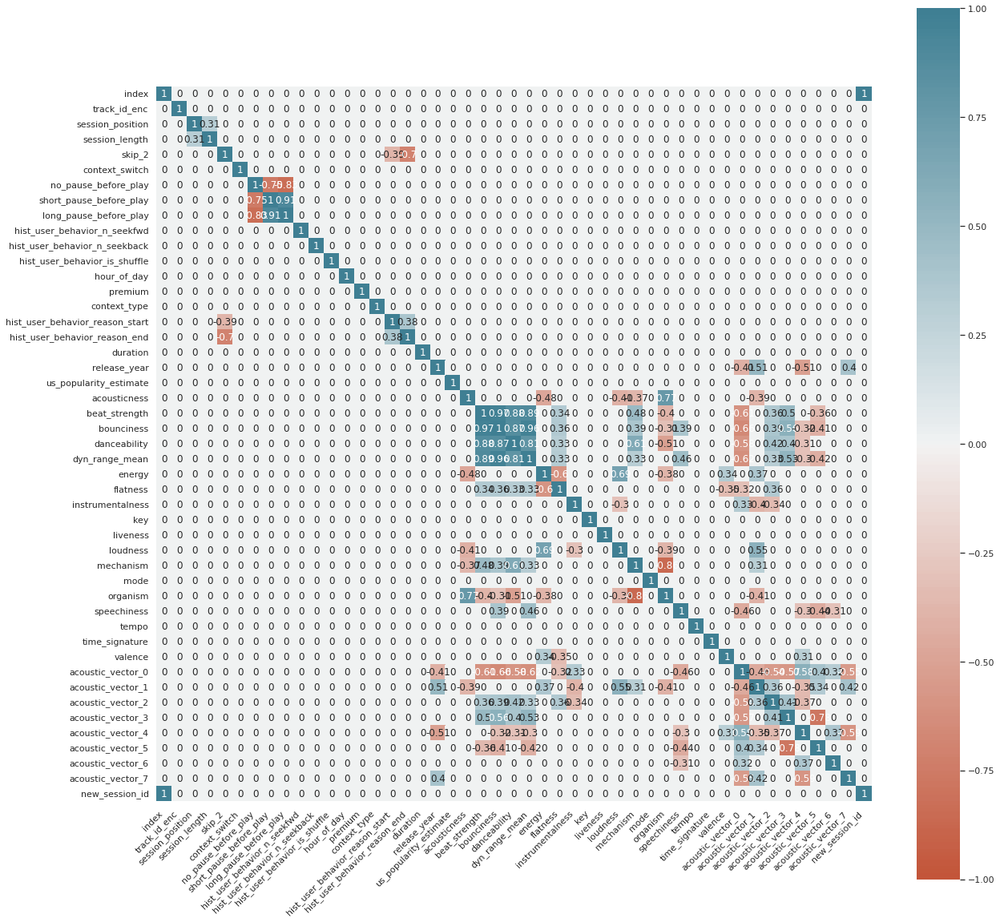

In [36]:
# corr = final_data.corr()
fig, ax = plt.subplots(figsize = (20,20))

subjective_corr = final_data.corr()
subjective_corr[np.abs(subjective_corr)<.3] = 0

ax = sns.heatmap(
    subjective_corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True, annot=True)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

***Principal-Component Analysis***

In [37]:
x_cols  = ["new_session_id", "session_position", "session_length", "track_id_enc", "context_switch", 
                     "us_popularity_estimate","acousticness", "beat_strength", "bounciness", 
                     "danceability", "dyn_range_mean", "energy", "flatness",
                     "instrumentalness", "key", "liveness", "loudness", 
                     "mechanism", "organism", "speechiness", "tempo",
                     "time_signature", "valence", "acoustic_vector_0",
                     "acoustic_vector_1", "acoustic_vector_2", "acoustic_vector_3",
                     "acoustic_vector_4", "acoustic_vector_5", "acoustic_vector_6",
                     "acoustic_vector_7", 'no_pause_before_play', 'short_pause_before_play',
                     'long_pause_before_play', 'hist_user_behavior_n_seekfwd',
                     'hist_user_behavior_n_seekback', 'hist_user_behavior_is_shuffle','premium']

In [38]:
# PCA
x = final_data.loc[:, x_cols].values
y = final_data.loc[:,['skip_2']].values

from sklearn.decomposition import PCA
pca = PCA(n_components=5)
principalComponents = pca.fit_transform(x)

principalDf = pd.DataFrame(data = principalComponents
             , columns = ['PC1', 'PC2', 'PC3', 'PC4', 'PC5'])

pca.explained_variance_ratio_

array([7.57224360e-01, 2.42775636e-01, 2.87858205e-09, 9.10680881e-10,
       3.64860252e-11])

In [39]:
# Testing the usefulness of the PCA components in prediction
from sklearn.linear_model import LogisticRegression

pca = PCA(.95)
pca.fit(x)
train_img = pca.transform(x)
test_img = y

logisticRegr = LogisticRegression(solver = 'lbfgs')
logisticRegr.fit(train_img, test_img)
logisticRegr.predict(train_img)
logisticRegr.score(train_img, test_img)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:985: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.5127504130429622

In [40]:
new_result = final_data.select_dtypes(exclude=['object'])
new_result = new_result.drop(columns=['new_session_id', 'track_id_enc', 'skip_2'])

target = final_data["skip_2"]

np_target = np.array(final_data["skip_2"])

np_target

array([0, 0, 0, ..., 1, 0, 1], dtype=int8)

# GaussianNB

In [41]:
#### GaussianNB

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(new_result, target, test_size=0.2,random_state=109)

In [42]:
y_test.head()

203044     0
2506162    0
2108023    1
337537     1
1407316    0
Name: skip_2, dtype: int8

In [43]:
from sklearn.naive_bayes import GaussianNB

#Create a Gaussian Classifier
gnb = GaussianNB()

#Train the model using the training sets
gnb.fit(X_train, y_train)

#Predict the response for test dataset
y_pred = gnb.predict(X_test)

In [44]:
from sklearn import metrics

# Model Accuracy
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.5193188011810299


In [45]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test, y_pred))

# TP FP
# FN TN

[[  3947 287462]
 [    44 306669]]


Text(73.7, 0.5, 'Predicted')

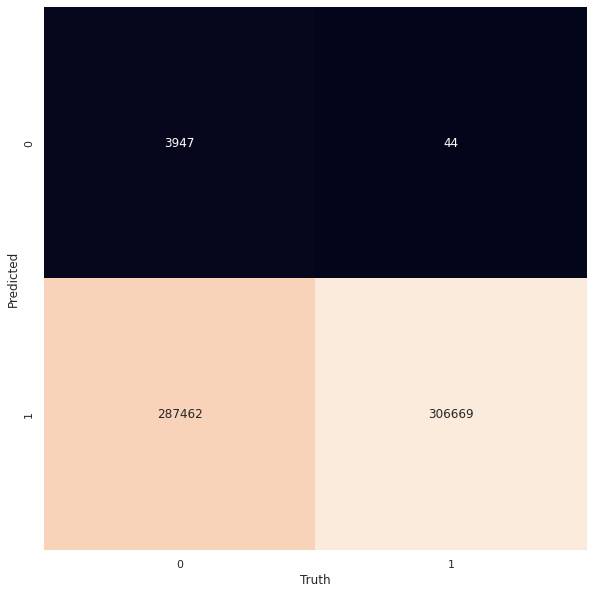

In [46]:
import seaborn as sns; sns.set()
from sklearn.metrics import confusion_matrix
import itertools
import matplotlib.ticker as ticker
fig, ax = plt.subplots(figsize = (10,10))
mat = confusion_matrix(y_pred, y_test)
names = np.unique(y_pred)
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar= False,
            xticklabels=names, yticklabels=names)
plt.xlabel('Truth')
plt.ylabel('Predicted')

In [47]:
#Accuracy = TP+TN/total
matrix = confusion_matrix(y_test, y_pred)
total = matrix[0][0]+matrix[0][1]+matrix[1][0]+matrix[1][1]
Accuracy = (matrix[0][0]+matrix[1][1])/total
Error_rate = (matrix[0][1]+matrix[1][0])/total

In [48]:
print(Accuracy)
print(Error_rate)

0.5193188011810299
0.48068119881897003


# Logistic Regression Model

In [49]:
new_result = final_data.select_dtypes(exclude=['object'])
new_result = new_result.drop(columns=['new_session_id', 'track_id_enc','skip_2'])

target = final_data["skip_2"]

np_target = np.array(final_data["skip_2"])

np_target

array([0, 0, 0, ..., 1, 0, 1], dtype=int8)

In [50]:
for col in final_data.columns: 
    print(col) 

index
track_id_enc
session_position
session_length
skip_2
context_switch
no_pause_before_play
short_pause_before_play
long_pause_before_play
hist_user_behavior_n_seekfwd
hist_user_behavior_n_seekback
hist_user_behavior_is_shuffle
hour_of_day
premium
context_type
hist_user_behavior_reason_start
hist_user_behavior_reason_end
duration
release_year
us_popularity_estimate
acousticness
beat_strength
bounciness
danceability
dyn_range_mean
energy
flatness
instrumentalness
key
liveness
loudness
mechanism
mode
organism
speechiness
tempo
time_signature
valence
acoustic_vector_0
acoustic_vector_1
acoustic_vector_2
acoustic_vector_3
acoustic_vector_4
acoustic_vector_5
acoustic_vector_6
acoustic_vector_7
new_session_id


In [51]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(new_result, target, test_size=0.3,random_state=109)

In [52]:
y_test.head()

203044     0
2506162    0
2108023    1
337537     1
1407316    0
Name: skip_2, dtype: int8

In [53]:
from sklearn.linear_model import LogisticRegression
logmodel = LogisticRegression(solver='lbfgs', max_iter=10000)
logmodel.fit(X_train, y_train)

LogisticRegression(max_iter=10000)

In [54]:
#predictions
Predictions = logmodel.predict(X_test)

In [55]:
#evaluation

from sklearn.metrics import classification_report
print(classification_report(y_test,Predictions))

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00    436921
           1       0.51      1.00      0.68    460262

    accuracy                           0.51    897183
   macro avg       0.26      0.50      0.34    897183
weighted avg       0.26      0.51      0.35    897183



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [56]:
from sklearn import metrics

# Model Accuracy, how often is the classifier correct
print("Accuracy:",metrics.accuracy_score(y_test, Predictions))

Accuracy: 0.5130079370652364


In [57]:
import statsmodels.api as sm
logit_model = sm.Logit(y_train, sm.add_constant(X_train)).fit()
print(logit_model.summary())

/usr/local/lib/python3.7/dist-packages/statsmodels/discrete/discrete_model.py:1736: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))


Optimization terminated successfully.
         Current function value: 0.328601
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                 skip_2   No. Observations:              2093426
Model:                          Logit   Df Residuals:                  2093381
Method:                           MLE   Df Model:                           44
Date:                Sun, 12 Dec 2021   Pseudo R-squ.:                  0.5257
Time:                        04:31:12   Log-Likelihood:            -6.8790e+05
converged:                       True   LL-Null:                   -1.4504e+06
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                      coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------
const                              11.3803      0.652     17.450  

In [58]:
#feature importance 
from sklearn.preprocessing import StandardScaler

In [59]:
# The estimated coefficients will all be around 1: attribute of the fitted model to see which features are most important. higher absolute value to be more important.
print(logmodel.coef_)

[[-9.03554701e-10  6.34463503e-07  7.85014049e-07 -2.94819964e-08
   9.86960755e-08 -2.02861222e-08 -5.14540029e-08  8.20785532e-09
  -3.91744836e-08  5.03864675e-08  3.45739733e-07  3.43336854e-09
   3.22750299e-07 -1.82288162e-06 -3.14313857e-06  4.49386308e-06
   2.54836257e-05  1.08351126e-08 -4.88710427e-09  6.62836451e-09
   8.70014383e-09  9.49724389e-09  3.46528270e-09  1.15136647e-08
   1.11004043e-08 -5.28870596e-09  7.42861591e-09  3.53772851e-09
   1.14784156e-08  3.87730815e-09  1.01698985e-08  3.67194925e-09
   6.74841093e-09  7.50253350e-09  1.05910277e-08  5.66685160e-09
  -5.35769130e-09  1.22676732e-08  1.16291325e-08  8.08548392e-09
   2.48888330e-09  7.30478782e-09 -1.67584057e-09  7.45735386e-09]]


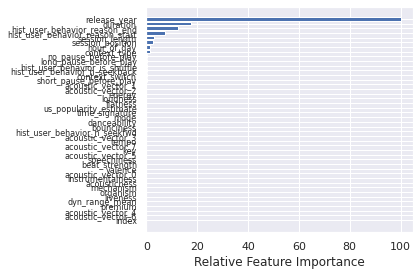

In [60]:
feature_importance = abs(logmodel.coef_[0])
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5

featfig = plt.figure()
featax = featfig.add_subplot(1, 1 ,1)
featax.barh(pos, feature_importance[sorted_idx], align='center')
featax.set_yticks(pos)
featax.set_yticklabels(np.array(X_train.columns)[sorted_idx], fontsize=8)
featax.set_xlabel('Relative Feature Importance')

plt.tight_layout()   
plt.show()

In [64]:
print(np.array(X_train.columns)[sorted_idx])

['index' 'acoustic_vector_6' 'acoustic_vector_4' 'premium'
 'dyn_range_mean' 'liveness' 'organism' 'mechanism' 'acousticness'
 'instrumentalness' 'acoustic_vector_0' 'valence' 'beat_strength'
 'speechiness' 'acoustic_vector_5' 'key' 'acoustic_vector_7' 'tempo'
 'acoustic_vector_3' 'hist_user_behavior_n_seekfwd' 'bounciness'
 'danceability' 'mode' 'time_signature' 'us_popularity_estimate'
 'flatness' 'loudness' 'energy' 'acoustic_vector_2' 'acoustic_vector_1'
 'short_pause_before_play' 'context_switch'
 'hist_user_behavior_n_seekback' 'hist_user_behavior_is_shuffle'
 'long_pause_before_play' 'no_pause_before_play' 'context_type'
 'hour_of_day' 'session_position' 'session_length'
 'hist_user_behavior_reason_start' 'hist_user_behavior_reason_end'
 'duration' 'release_year']
